# 🏙️🔥 Urban Heat Island (UHI) Severity Prediction

## 🎛️ Preliminaries

In [1]:
# from google.colab import drive
# drive.mount('/content/drive')

In [2]:
# Supress Warnings
import warnings
warnings.filterwarnings('ignore')


# Visualization
import matplotlib.pyplot as plt
import seaborn as sns

# Data Science
import numpy as np
import pandas as pd

# Multi-dimensional arrays and datasets
import xarray as xr

# Geospatial raster data handling
import rioxarray as rxr

# Geospatial data analysis
import geopandas as gpd

# Geospatial operations
import rasterio
from rasterio import windows
from rasterio import features
from rasterio import warp
from rasterio.warp import transform_bounds
from rasterio.windows import from_bounds
from matplotlib.cm import jet,RdYlGn

# Planetary Computer tools
import stackstac
import pystac_client
import planetary_computer
from odc.stac import stac_load

# Image Processing
from PIL import Image

# Coordinate transformations
from pyproj import Proj, Transformer, CRS

# Feature Engineering
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

# Machine Learning
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score

# Others
from tqdm import tqdm
import os

In [3]:
# Load ground-level data
base_dir = os.path.dirname(os.getcwd())
ground_path = os.path.join(base_dir, "data", "NY_Mesonet_Weather.xlsx")

if os.path.exists(ground_path):
  print("Found data file in local directory.")
  ground_manhattan_df = pd.read_excel(ground_path, sheet_name="Manhattan")
  ground_bronx_df = pd.read_excel(ground_path, sheet_name="Bronx")

else:
    raise FileNotFoundError(f"File not found at: {ground_path}")

Found data file in local directory.


In [4]:
ground_manhattan_df.head()

,Date / Time,Air Temp at Surface [degC],Relative Humidity [percent],Avg Wind Speed [m/s],Wind Direction [degrees],Solar Flux [W/m^2]
0,2021-07-24 06:00:00 EDT,21.3,66.5,0.9,348,10
1,2021-07-24 06:05:00 EDT,21.4,66.1,1.1,345,12
2,2021-07-24 06:10:00 EDT,21.4,66.5,1.3,4,14
3,2021-07-24 06:15:00 EDT,21.5,65.4,1.3,5,17
4,2021-07-24 06:20:00 EDT,21.5,65.0,1.5,346,19


In [5]:
ground_bronx_df.head()

,Date / Time,Air Temp at Surface [degC],Relative Humidity [percent],Avg Wind Speed [m/s],Wind Direction [degrees],Solar Flux [W/m^2]
0,2021-07-24 06:00:00 EDT,19.3,88.2,0.8,335,12
1,2021-07-24 06:05:00 EDT,19.4,87.9,0.8,329,18
2,2021-07-24 06:10:00 EDT,19.3,87.6,0.7,321,25
3,2021-07-24 06:15:00 EDT,19.4,87.4,0.5,307,33
4,2021-07-24 06:20:00 EDT,19.4,87.0,0.2,301,42


In [6]:
# Combine the New York boroughs into a single DataFrame
ground_manhattan_df["Borough"] = "Manhattan"
ground_bronx_df["Borough"] = "Bronx"

ground_combined_df = pd.concat([ground_manhattan_df, ground_bronx_df], ignore_index=True)
ground_combined_df

,Date / Time,Air Temp at Surface [degC],Relative Humidity [percent],Avg Wind Speed [m/s],Wind Direction [degrees],Solar Flux [W/m^2],Borough
0,2021-07-24 06:00:00 EDT,21.3,66.5,0.9,348,10,Manhattan
1,2021-07-24 06:05:00 EDT,21.4,66.1,1.1,345,12,Manhattan
2,2021-07-24 06:10:00 EDT,21.4,66.5,1.3,4,14,Manhattan
3,2021-07-24 06:15:00 EDT,21.5,65.4,1.3,5,17,Manhattan
4,2021-07-24 06:20:00 EDT,21.5,65.0,1.5,346,19,Manhattan
...,...,...,...,...,...,...,...
333,2021-07-24 19:40:00 EDT,24.9,49.0,3.5,184,24,Bronx
334,2021-07-24 19:45:00 EDT,24.8,49.0,3.3,173,19,Bronx
335,2021-07-24 19:50:00 EDT,24.9,48.7,3.8,168,17,Bronx
336,2021-07-24 19:55:00 EDT,24.9,47.3,4.1,171,16,Bronx


In [7]:
station_coords = {
    "Manhattan": {"Latitude": 40.76754, "Longitude": -73.96449},
    "Bronx": {"Latitude": 40.87248, "Longitude": -73.89352}
}

ground_combined_df["Latitude"] = ground_combined_df["Borough"].map(lambda x: station_coords[x]["Latitude"])
ground_combined_df["Longitude"] = ground_combined_df["Borough"].map(lambda x: station_coords[x]["Longitude"])

In [8]:
# Since 'Air Temp at Surface [degC] is used to calculate the UHI Index, we will exclude it from the input features
ground_combined_df = ground_combined_df[["Longitude", "Latitude", "Date / Time",
                                         "Avg Wind Speed [m/s]", "Wind Direction [degrees]", "Solar Flux [W/m^2]", "Borough"]]
ground_combined_df

,Longitude,Latitude,Date / Time,Avg Wind Speed [m/s],Wind Direction [degrees],Solar Flux [W/m^2],Borough
0,-73.96449,40.76754,2021-07-24 06:00:00 EDT,0.9,348,10,Manhattan
1,-73.96449,40.76754,2021-07-24 06:05:00 EDT,1.1,345,12,Manhattan
2,-73.96449,40.76754,2021-07-24 06:10:00 EDT,1.3,4,14,Manhattan
3,-73.96449,40.76754,2021-07-24 06:15:00 EDT,1.3,5,17,Manhattan
4,-73.96449,40.76754,2021-07-24 06:20:00 EDT,1.5,346,19,Manhattan
...,...,...,...,...,...,...,...
333,-73.89352,40.87248,2021-07-24 19:40:00 EDT,3.5,184,24,Bronx
334,-73.89352,40.87248,2021-07-24 19:45:00 EDT,3.3,173,19,Bronx
335,-73.89352,40.87248,2021-07-24 19:50:00 EDT,3.8,168,17,Bronx
336,-73.89352,40.87248,2021-07-24 19:55:00 EDT,4.1,171,16,Bronx


In [9]:
base_dir = os.path.dirname(os.getcwd())
ground_path = os.path.join(base_dir, "data", "NY_Mesonet_Weather.xlsx")
ground_uhi_path = os.path.join(base_dir, "data", "Training_data_uhi_index_UHI2025-v2.csv")

if os.path.exists(ground_uhi_path):
  print("Found data file in local directory.")
  ground_uhi_df = pd.read_csv(ground_uhi_path)

else:
  raise FileNotFoundError(f"File not found at: {ground_uhi_path}")

Found data file in local directory.


In [10]:
ground_uhi_df.head()

,Longitude,Latitude,datetime,UHI Index
0,-73.909167,40.813107,24-07-2021 15:53,1.030289
1,-73.909187,40.813045,24-07-2021 15:53,1.030289
2,-73.909215,40.812978,24-07-2021 15:53,1.023798
3,-73.909242,40.812908,24-07-2021 15:53,1.023798
4,-73.909257,40.812845,24-07-2021 15:53,1.021634


## 🛠️ Data Preprocessing

In [11]:
# 📍 Preparing ground-level data
ground_combined_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 338 entries, 0 to 337
Data columns (total 7 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Longitude                 338 non-null    float64
 1   Latitude                  338 non-null    float64
 2   Date / Time               338 non-null    object 
 3   Avg Wind Speed [m/s]      338 non-null    float64
 4   Wind Direction [degrees]  338 non-null    int64  
 5   Solar Flux [W/m^2]        338 non-null    int64  
 6   Borough                   338 non-null    object 
dtypes: float64(3), int64(2), object(2)
memory usage: 18.6+ KB


In [12]:
# Check for missing values
missing_values = ground_combined_df.isna().sum()
print("\n Missing values in each column")
print(missing_values)


 Missing values in each column
Longitude                   0
Latitude                    0
Date / Time                 0
Avg Wind Speed [m/s]        0
Wind Direction [degrees]    0
Solar Flux [W/m^2]          0
Borough                     0
dtype: int64


In [13]:
# (If there is missing values) For numeric columns, fill missing values with their mean
numeric_cols = ground_combined_df.select_dtypes(include=['number']).columns

ground_combined_df[numeric_cols] = ground_combined_df[numeric_cols].fillna(ground_combined_df[numeric_cols].mean())

In [14]:
# For categorical columns, fill missing values with their mode
ground_combined_df['Borough'] = ground_combined_df['Borough'].fillna(ground_combined_df['Borough'].mode()[0])

In [15]:
ground_combined_df

,Longitude,Latitude,Date / Time,Avg Wind Speed [m/s],Wind Direction [degrees],Solar Flux [W/m^2],Borough
0,-73.96449,40.76754,2021-07-24 06:00:00 EDT,0.9,348,10,Manhattan
1,-73.96449,40.76754,2021-07-24 06:05:00 EDT,1.1,345,12,Manhattan
2,-73.96449,40.76754,2021-07-24 06:10:00 EDT,1.3,4,14,Manhattan
3,-73.96449,40.76754,2021-07-24 06:15:00 EDT,1.3,5,17,Manhattan
4,-73.96449,40.76754,2021-07-24 06:20:00 EDT,1.5,346,19,Manhattan
...,...,...,...,...,...,...,...
333,-73.89352,40.87248,2021-07-24 19:40:00 EDT,3.5,184,24,Bronx
334,-73.89352,40.87248,2021-07-24 19:45:00 EDT,3.3,173,19,Bronx
335,-73.89352,40.87248,2021-07-24 19:50:00 EDT,3.8,168,17,Bronx
336,-73.89352,40.87248,2021-07-24 19:55:00 EDT,4.1,171,16,Bronx


In [16]:
ground_uhi_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11229 entries, 0 to 11228
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Longitude  11229 non-null  float64
 1   Latitude   11229 non-null  float64
 2   datetime   11229 non-null  object 
 3   UHI Index  11229 non-null  float64
dtypes: float64(3), object(1)
memory usage: 351.0+ KB


In [17]:
# Check for missing values
missing_value = ground_uhi_df.isna().sum()
print("\n Missing values in each column")
print(missing_values)


 Missing values in each column
Longitude                   0
Latitude                    0
Date / Time                 0
Avg Wind Speed [m/s]        0
Wind Direction [degrees]    0
Solar Flux [W/m^2]          0
Borough                     0
dtype: int64


In [18]:
# (If there is missing values) For numeric columns, fill missing values with their mean
numeric_cols = ground_uhi_df.select_dtypes(include=['number']).columns

ground_uhi_df[numeric_cols] = ground_uhi_df[numeric_cols].fillna(ground_uhi_df[numeric_cols].mean())

In [19]:
# Converting the 'Date / Time' column to datetime
ground_combined_df['Date / Time'] = pd.to_datetime(ground_combined_df['Date / Time'])
ground_uhi_df['datetime'] = pd.to_datetime(ground_uhi_df['datetime'])

In [20]:
ground_combined_df

,Longitude,Latitude,Date / Time,Avg Wind Speed [m/s],Wind Direction [degrees],Solar Flux [W/m^2],Borough
0,-73.96449,40.76754,2021-07-24 06:00:00,0.9,348,10,Manhattan
1,-73.96449,40.76754,2021-07-24 06:05:00,1.1,345,12,Manhattan
2,-73.96449,40.76754,2021-07-24 06:10:00,1.3,4,14,Manhattan
3,-73.96449,40.76754,2021-07-24 06:15:00,1.3,5,17,Manhattan
4,-73.96449,40.76754,2021-07-24 06:20:00,1.5,346,19,Manhattan
...,...,...,...,...,...,...,...
333,-73.89352,40.87248,2021-07-24 19:40:00,3.5,184,24,Bronx
334,-73.89352,40.87248,2021-07-24 19:45:00,3.3,173,19,Bronx
335,-73.89352,40.87248,2021-07-24 19:50:00,3.8,168,17,Bronx
336,-73.89352,40.87248,2021-07-24 19:55:00,4.1,171,16,Bronx


In [21]:
ground_uhi_df

,Longitude,Latitude,datetime,UHI Index
0,-73.909167,40.813107,2021-07-24 15:53:00,1.030289
1,-73.909187,40.813045,2021-07-24 15:53:00,1.030289
2,-73.909215,40.812978,2021-07-24 15:53:00,1.023798
3,-73.909242,40.812908,2021-07-24 15:53:00,1.023798
4,-73.909257,40.812845,2021-07-24 15:53:00,1.021634
...,...,...,...,...
11224,-73.957050,40.790333,2021-07-24 15:57:00,0.972470
11225,-73.957063,40.790308,2021-07-24 15:57:00,0.972470
11226,-73.957093,40.790270,2021-07-24 15:57:00,0.981124
11227,-73.957112,40.790253,2021-07-24 15:59:00,0.981245


In [22]:
from geopy.distance import geodesic

# Temporal nearest-neighbor matching
def map_ground_data(ground_uhi_df: pd.DataFrame,
                    ground_combined_df: pd.DataFrame,
                    time_col_uhi: str = 'datetime',
                    time_col_ground: str = 'Date / Time',
                    lon_col: str = 'Longitude',
                    lat_col: str = 'Latitude',
                    tolerance_minutes: int = 5,
                    max_distance_meters: int = 7000) -> pd.DataFrame:
  """
  # Matches ground-level meteorological data to UHI index points using spatiotemporal nearest-neighbor matching.

  Parameters:
    ground_uhi_df (pd.DataFrame): DataFrame containing UHI data with datetime, lat, lon.
    ground_combined_df (pd.DataFrame): Ground-level sensor data with timestamp and meteorological features.
    time_col_uhi (str): Column name for datetime in UHI dataset.
    time_col_ground (str): Column name for datetime in ground dataset.
    lat_col (str): Column name for latitude in both datasets.
    lon_col (str): Column name for longitude in both datasets.
    tolerance_minutes (int): Time matching tolerance window in minutes.
    max_distance_meters (int): Maximum spatial distance (in meters) to consider a valid match.
  """

  ground_uhi_df = ground_uhi_df.copy()
  ground_combined_df = ground_combined_df.copy()

  # Initialize empty lists to store matched ground-level data
  matched_rows = []

  for _, uhi_row in tqdm(ground_uhi_df.iterrows(), total=len(ground_uhi_df), desc="Mapping ground data"):
    uhi_time = uhi_row[time_col_uhi]
    uhi_lat = uhi_row[lat_col]
    uhi_lon = uhi_row[lon_col]

    # Time filter
    ground_combined_df['time_difference'] = (ground_combined_df[time_col_ground] - uhi_time).abs()
    window = pd.Timedelta(minutes=tolerance_minutes)
    time_candidates = ground_combined_df[ground_combined_df['time_difference'] <= window]

    # Spatial filter
    spatial_candidates = time_candidates.copy()
    spatial_candidates['distance'] = spatial_candidates.apply(lambda row: geodesic((uhi_lat, uhi_lon), (row[lat_col], row[lon_col])).meters, axis=1)
    spatial_candidates = spatial_candidates[spatial_candidates['distance'] <= max_distance_meters]

    if not spatial_candidates.empty:
      best_match = spatial_candidates.loc[spatial_candidates['time_difference'].idxmin()]
      matched_rows.append(best_match.drop(labels=['distance']))

    else:
      matched_rows.append(pd.Series([np.nan] * len(ground_combined_df.columns), index=ground_combined_df.columns))

  matched_df = pd.DataFrame(matched_rows).reset_index(drop=True)
  combined = pd.concat([ground_uhi_df.reset_index(drop=True), matched_df], axis=1)

  return combined

In [23]:
mapped_ground_df = map_ground_data(ground_uhi_df, ground_combined_df)

Mapping ground data: 100%|██████████| 11229/11229 [00:20<00:00, 536.01it/s]


In [24]:
mapped_ground_df

,Longitude,Latitude,datetime,UHI Index,Longitude,Latitude,Date / Time,Avg Wind Speed [m/s],Wind Direction [degrees],Solar Flux [W/m^2],Borough,time_difference
0,-73.909167,40.813107,2021-07-24 15:53:00,1.030289,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
1,-73.909187,40.813045,2021-07-24 15:53:00,1.030289,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
2,-73.909215,40.812978,2021-07-24 15:53:00,1.023798,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
3,-73.909242,40.812908,2021-07-24 15:53:00,1.023798,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
4,-73.909257,40.812845,2021-07-24 15:53:00,1.021634,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
...,...,...,...,...,...,...,...,...,...,...,...,...
11224,-73.957050,40.790333,2021-07-24 15:57:00,0.972470,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
11225,-73.957063,40.790308,2021-07-24 15:57:00,0.972470,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
11226,-73.957093,40.790270,2021-07-24 15:57:00,0.981124,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
11227,-73.957112,40.790253,2021-07-24 15:59:00,0.981245,-73.96449,40.76754,2021-07-24 16:00:00,2.7,209.0,620.0,Manhattan,0 days 00:01:00


In [25]:
mapped_ground_df.isna().sum()

Longitude                     0
Latitude                      0
datetime                      0
UHI Index                     0
Longitude                   287
Latitude                    287
Date / Time                 287
Avg Wind Speed [m/s]        287
Wind Direction [degrees]    287
Solar Flux [W/m^2]          287
Borough                     287
time_difference             287
dtype: int64

In [26]:
# Removing unmapped matching
mapped_ground_df = mapped_ground_df.dropna().reset_index(drop=True)

In [27]:
mapped_ground_df.isna().sum()

Longitude                   0
Latitude                    0
datetime                    0
UHI Index                   0
Longitude                   0
Latitude                    0
Date / Time                 0
Avg Wind Speed [m/s]        0
Wind Direction [degrees]    0
Solar Flux [W/m^2]          0
Borough                     0
time_difference             0
dtype: int64

In [28]:
mapped_ground_df

,Longitude,Latitude,datetime,UHI Index,Longitude,Latitude,Date / Time,Avg Wind Speed [m/s],Wind Direction [degrees],Solar Flux [W/m^2],Borough,time_difference
0,-73.909167,40.813107,2021-07-24 15:53:00,1.030289,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
1,-73.909187,40.813045,2021-07-24 15:53:00,1.030289,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
2,-73.909215,40.812978,2021-07-24 15:53:00,1.023798,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
3,-73.909242,40.812908,2021-07-24 15:53:00,1.023798,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
4,-73.909257,40.812845,2021-07-24 15:53:00,1.021634,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
...,...,...,...,...,...,...,...,...,...,...,...,...
10937,-73.957050,40.790333,2021-07-24 15:57:00,0.972470,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
10938,-73.957063,40.790308,2021-07-24 15:57:00,0.972470,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
10939,-73.957093,40.790270,2021-07-24 15:57:00,0.981124,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
10940,-73.957112,40.790253,2021-07-24 15:59:00,0.981245,-73.96449,40.76754,2021-07-24 16:00:00,2.7,209.0,620.0,Manhattan,0 days 00:01:00


In [29]:
# Check for duplicate rows
mapped_ground_df.duplicated().sum()

np.int64(0)

In [30]:
environ_cols = [
    'Longitude',
    'Latitude',
    'Avg Wind Speed [m/s]',
    'Wind Direction [degrees]',
    'Solar Flux [W/m^2]',
    'Borough'
]

# Drop duplicates based on selected features
mapped_ground_df = mapped_ground_df.drop_duplicates(subset=environ_cols, keep='first').reset_index(drop=True)

In [31]:
mapped_ground_df

,Longitude,Latitude,datetime,UHI Index,Longitude,Latitude,Date / Time,Avg Wind Speed [m/s],Wind Direction [degrees],Solar Flux [W/m^2],Borough,time_difference
0,-73.909167,40.813107,2021-07-24 15:53:00,1.030289,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
1,-73.909187,40.813045,2021-07-24 15:53:00,1.030289,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
2,-73.909215,40.812978,2021-07-24 15:53:00,1.023798,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
3,-73.909242,40.812908,2021-07-24 15:53:00,1.023798,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
4,-73.909257,40.812845,2021-07-24 15:53:00,1.021634,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
...,...,...,...,...,...,...,...,...,...,...,...,...
10937,-73.957050,40.790333,2021-07-24 15:57:00,0.972470,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
10938,-73.957063,40.790308,2021-07-24 15:57:00,0.972470,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
10939,-73.957093,40.790270,2021-07-24 15:57:00,0.981124,-73.96449,40.76754,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
10940,-73.957112,40.790253,2021-07-24 15:59:00,0.981245,-73.96449,40.76754,2021-07-24 16:00:00,2.7,209.0,620.0,Manhattan,0 days 00:01:00


In [32]:
# 🛰️ Preparing satellite data

# Define the bounding box for the entire data region using (Latitude, Longitude)
# This is the region of New York City that contains our temperature dataset
lower_left = (40.75, -74.01)
upper_right = (40.88, -73.86)

In [33]:
# Calculate the bounds for doing an archive data search
# bounds = (min_lon, min_lat, max_lon, max_lat)
bounds = (lower_left[1], lower_left[0], upper_right[1], upper_right[0])

In [34]:
# Define the time window
time_window = "2021-06-01/2021-09-01"

In [35]:
stac = pystac_client.Client.open("https://planetarycomputer.microsoft.com/api/stac/v1")

search_sentinel = stac.search(
    bbox=bounds,
    datetime=time_window,
    collections=["sentinel-2-l2a"],
    query={"eo:cloud_cover": {"lt": 20}},
)

In [36]:
items_sentinel = list(search_sentinel.get_items())
print('This is the number of scenes that touch our region:',len(items_sentinel))

This is the number of scenes that touch our region: 7


In [37]:
signed_items_sentinel = [planetary_computer.sign(item) for item in items_sentinel]

In [38]:
stac = pystac_client.Client.open("https://planetarycomputer.microsoft.com/api/stac/v1")

search_landsat = stac.search(
    bbox=bounds,
    datetime=time_window,
    collections=["landsat-c2-l2"],
    query={"eo:cloud_cover": {"lt": 20},"platform": {"in": ["landsat-8"]}},
)

In [39]:
items_landsat = list(search_landsat.get_items())
print('This is the number of scenes that touch our region:',len(items_landsat))

This is the number of scenes that touch our region: 5


In [40]:
signed_items_landsat = [planetary_computer.sign(item) for item in items_landsat]

In [41]:
# Define the pixel resolution for the final product
# Define the scale according to our selected crs, so we will use degrees
resolution = 10  # meters per pixel
scale = resolution / 111320.0 # degrees per pixel for crs=4326

In [42]:
data_sentinel = stac_load(
    signed_items_sentinel,
    bands=["B01", "B02", "B03", "B04", "B05", "B06", "B07", "B08", "B8A", "B11", "B12"],
    crs="EPSG:4326", # Latitude-Longitude
    resolution=scale, # Degrees
    chunks={"x": 2048, "y": 2048},
    dtype="uint16",
    patch_url=planetary_computer.sign,
    bbox=bounds
)

In [43]:
# View the dimensions of our XARRAY and the loaded variables
# This insures we have the right coordinates and spectral bands in our xarray
print(data_sentinel)

<xarray.Dataset> Size: 373MB
Dimensions:      (latitude: 1448, longitude: 1671, time: 7)
Coordinates:
  * latitude     (latitude) float64 12kB 40.88 40.88 40.88 ... 40.75 40.75 40.75
  * longitude    (longitude) float64 13kB -74.01 -74.01 -74.01 ... -73.86 -73.86
    spatial_ref  int32 4B 4326
  * time         (time) datetime64[ns] 56B 2021-06-06T15:38:09.024000 ... 202...
Data variables:
    B01          (time, latitude, longitude) uint16 34MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    B02          (time, latitude, longitude) uint16 34MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    B03          (time, latitude, longitude) uint16 34MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    B04          (time, latitude, longitude) uint16 34MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    B05          (time, latitude, longitude) uint16 34MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    B06          (time, latitude, longitude) uin

In [44]:
data1_landsat = stac_load(
    signed_items_landsat,
    bands=["red", "green", "blue", "nir08", "swir16", "swir22"],
    crs="EPSG:4326", # Latitude-Longitude
    resolution=scale, # Degrees
    chunks={"x": 2048, "y": 2048},
    dtype="uint16",
    patch_url=planetary_computer.sign,
    bbox=bounds
)

In [45]:
data2_landsat = stac_load(
    signed_items_landsat,
    bands=["lwir11"],
    crs="EPSG:4326", # Latitude-Longitude
    resolution=scale, # Degrees
    chunks={"x": 2048, "y": 2048},
    dtype="uint16",
    patch_url=planetary_computer.sign,
    bbox=bounds
)

In [46]:
# View the dimensions of our XARRAY and the loaded variables
# This insures we have the right coordinates and spectral bands in our xarray
print(data1_landsat)
print(data2_landsat)

<xarray.Dataset> Size: 145MB
Dimensions:      (latitude: 1448, longitude: 1671, time: 5)
Coordinates:
  * latitude     (latitude) float64 12kB 40.88 40.88 40.88 ... 40.75 40.75 40.75
  * longitude    (longitude) float64 13kB -74.01 -74.01 -74.01 ... -73.86 -73.86
    spatial_ref  int32 4B 4326
  * time         (time) datetime64[ns] 40B 2021-06-07T15:39:15.904901 ... 202...
Data variables:
    red          (time, latitude, longitude) uint16 24MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    green        (time, latitude, longitude) uint16 24MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    blue         (time, latitude, longitude) uint16 24MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    nir08        (time, latitude, longitude) uint16 24MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    swir16       (time, latitude, longitude) uint16 24MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    swir22       (time, latitude, longitude) uin

In [47]:
# Persist the data in memory for faster operations
data1_landsat = data1_landsat.persist()
data2_landsat = data2_landsat.persist()

In [48]:
# Scale Factors for the RGB and NIR bands
scale1 = 0.0000275
offset1 = -0.2
data1_landsat = data1_landsat.astype(float) * scale1 + offset1

In [49]:
# Scale Factors for the Surface Temperature band
scale2 = 0.00341802
offset2 = 149.0
kelvin_celsius = 273.15 # convert from Kelvin to Celsius
data2_landsat = data2_landsat.astype(float) * scale2 + offset2 - kelvin_celsius

In [50]:
print(signed_items_sentinel[0].assets["B04"].href)

https://sentinel2l2a01.blob.core.windows.net/sentinel2-l2/18/T/WL/2021/08/13/S2A_MSIL2A_20210813T154911_N0300_R054_T18TWL_20210814T063950.SAFE/GRANULE/L2A_T18TWL_A032083_20210813T155956/IMG_DATA/R10m/T18TWL_20210813T154911_B04_10m.tif?st=2025-05-11T03%3A25%3A48Z&se=2025-05-12T04%3A10%3A48Z&sp=rl&sv=2024-05-04&sr=c&skoid=9c8ff44a-6a2c-4dfb-b298-1c9212f64d9a&sktid=72f988bf-86f1-41af-91ab-2d7cd011db47&skt=2025-05-12T03%3A23%3A32Z&ske=2025-05-19T03%3A23%3A32Z&sks=b&skv=2024-05-04&sig=oXjLL9qvPnqLb1dldk/cUcIYHczi1jFKbapJPep8Wrs%3D


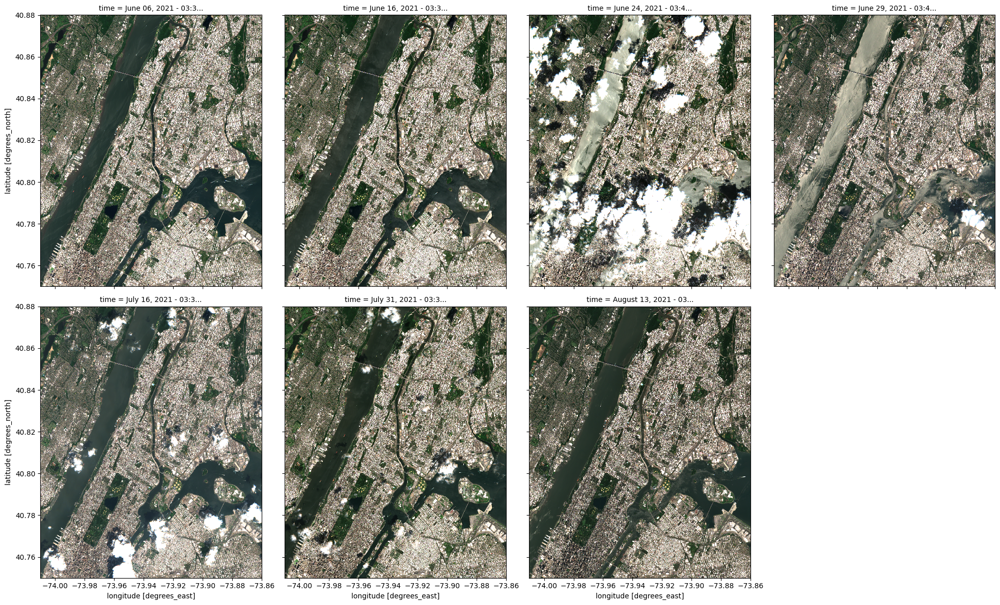

In [51]:
# Plot sample images from the time series
plot_data_sentinel = data_sentinel[["B04","B03","B02"]].to_array()

# Format the time axis with readable date strings
formatted_time = pd.to_datetime(plot_data_sentinel["time"].values).strftime("%B %d, %Y - %I:%M %p")

# Reassign the formatted time labels back to the array
plot_data_sentinel.coords["time"] = ("time", formatted_time.astype(str))

plot_data_sentinel.plot.imshow(col='time', col_wrap=4, figsize = (20,12), robust=True, vmin=0, vmax=2500)
plt.show()

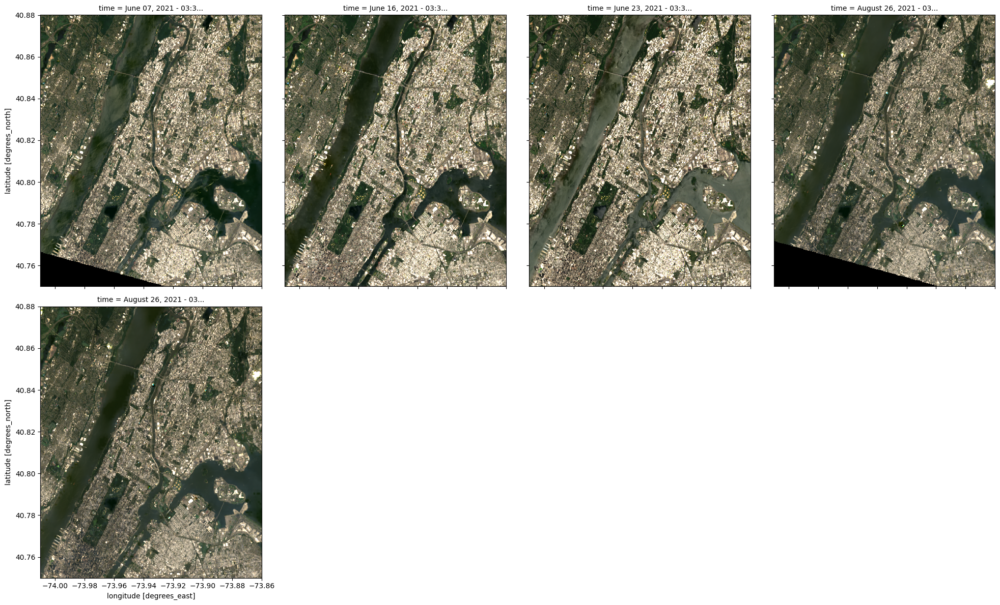

In [52]:
plot_data_landsat = data1_landsat[["red","green","blue"]].to_array()

# Format the time axis with readable date strings
formatted_time = pd.to_datetime(plot_data_landsat["time"].values).strftime("%B %d, %Y - %I:%M %p")
unique_time_labels = [f"{t} ({i})" for i, t in enumerate(formatted_time)]

# Reassign the formatted time labels back to the array
plot_data_landsat.coords["time"] = ("time", unique_time_labels)

plot_data_landsat.plot.imshow(col='time', col_wrap=4, figsize = (20,12), robust=True, vmin=0, vmax=0.25)
plt.show()

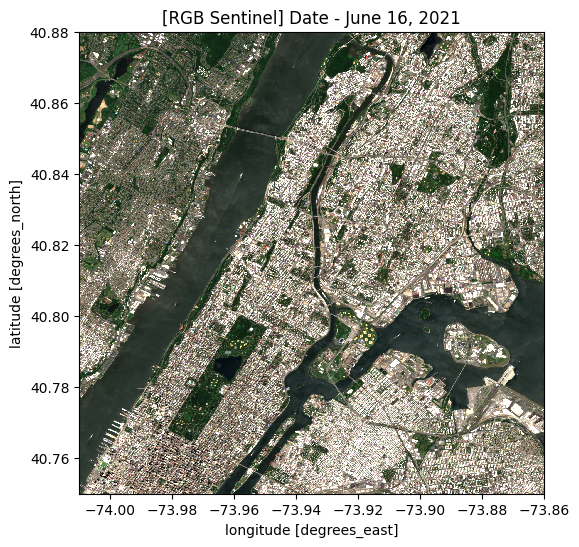

In [53]:
# Plot an image for a single date (Sentinel) (June 16, 2021)
fig, ax = plt.subplots(figsize=(6,6))
plot_data_sentinel.isel(time=1).plot.imshow(robust=True, ax=ax, vmin=0, vmax=2500)
ax.set_title("[RGB Sentinel] Date - June 16, 2021")
plt.show()

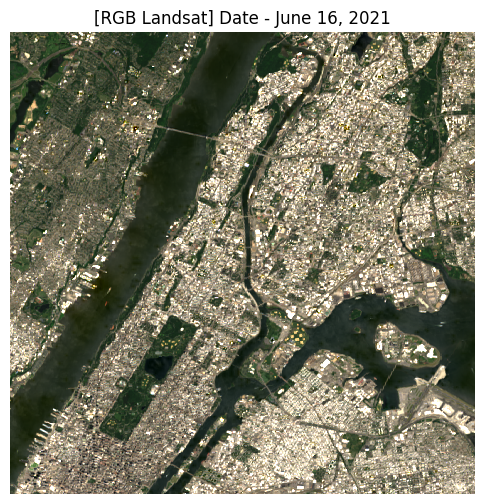

In [54]:
# Plot an image for a single date (Landsat) (June 16, 2021)
fig, ax = plt.subplots(figsize=(6,6))
data1_landsat.isel(time=1)[["red", "green", "blue"]].to_array().plot.imshow(robust=True, ax=ax, vmin=0.0, vmax=0.25)
ax.set_title("[RGB Landsat] Date - June 16, 2021")
ax.axis('off')
plt.show()

Median Composite

We compute the median composite to reduce the impact of clouds. Since each scene has less than 20% cloud cover and cloud appears in different places across images, taking the median over time helps remove them. Cloud pixels are usually outliers, so they are unlikely to be the median value at any location

In [55]:
median_sentinel = data_sentinel.median(dim="time").compute()

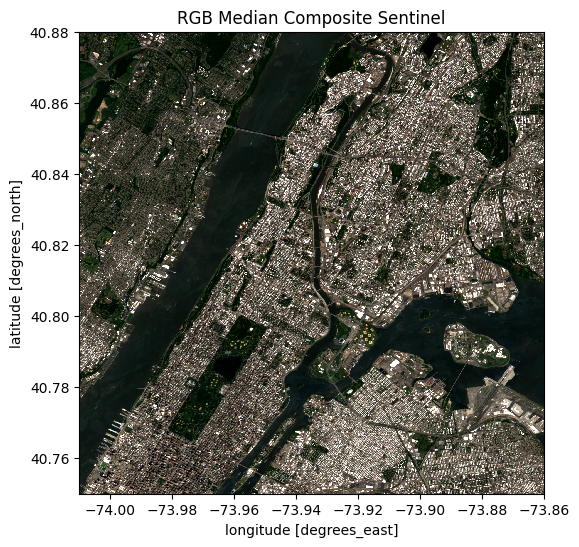

In [56]:
# Plot an RGB image for the median composite or mosaic
# Notice how this new image is void of clouds due to statistical filtering
fig, ax = plt.subplots(figsize=(6,6))
median_sentinel[["B04", "B03", "B02"]].to_array().plot.imshow(robust=True, ax=ax)
ax.set_title("RGB Median Composite Sentinel")
plt.show()

In [57]:
median_landsat1 = data1_landsat.median(dim="time").compute()
median_landsat2 = data2_landsat.median(dim="time").compute()

In [58]:
# Merge the two landsat median composites
median_landsat = xr.merge([median_landsat1, median_landsat2])

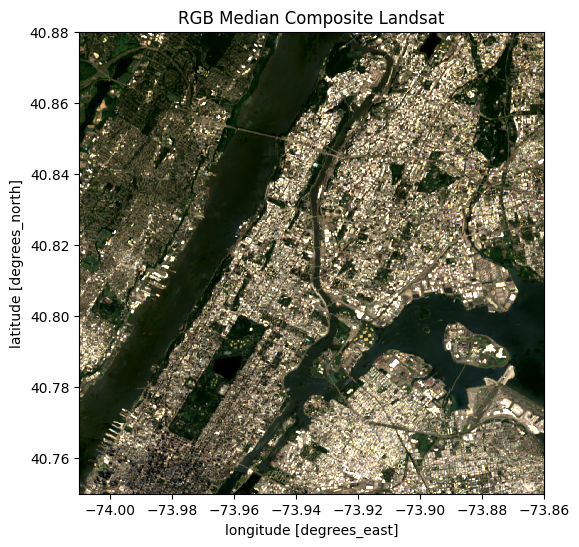

In [59]:
# Plot an RGB image for the median composite or mosaic
# Notice how this new image is void of clouds due to statistical filtering
fig, ax = plt.subplots(figsize=(6,6))
median_landsat[["red", "green", "blue"]].to_array().plot.imshow(robust=True, ax=ax)
ax.set_title("RGB Median Composite Landsat")
plt.show()

In [60]:
# Spatial nearest-neighbor matching

def map_satellite_data(median: xr.Dataset, uhi_df: pd.DataFrame) -> pd.DataFrame:
    """
    Maps spatially nearest satellite median composite band values to UHI coordinate points.

    For each (latitude, longitude) in the UHI dataset, this function extracts the nearest pixel
    value from each band in the satellite median composite and returns them as a DataFrame.

    Parameters:
        median (xr.Dataset): xarray Dataset containing median values of all satellite bands.
                             Should include coordinates 'latitude' and 'longitude'.
        uhi_df (pd.DataFrame): DataFrame with 'Latitude' and 'Longitude' columns for UHI points.

    Returns:
        pd.DataFrame: A DataFrame containing the extracted satellite band values (one row per UHI point).
    """
    # Extract lat/lon from UHI DataFrame
    latitudes = uhi_df['Latitude'].values
    longitudes = uhi_df['Longitude'].values

    band_names = list(median.data_vars)

    # Dictionary to store extracted values
    band_values = {band: [] for band in band_names}

    for lat, lon in tqdm(zip(latitudes, longitudes), total=len(latitudes), desc="Mapping satellite data"):
      for band in band_names:
        # Select the nearest pixel value for each band
        value = median[band].sel(latitude=lat, longitude=lon, method='nearest').values.item()
        band_values[band].append(value)

    # Convert to DataFrame
    satellite_df = pd.DataFrame(band_values)

    return satellite_df

In [61]:
sentinel_features = map_satellite_data(median_sentinel, ground_uhi_df)

Mapping satellite data: 100%|██████████| 11229/11229 [00:37<00:00, 297.69it/s]


In [62]:
# Check for duplicate rows
sentinel_features.duplicated().sum()

np.int64(2997)

In [63]:
landsat_features = map_satellite_data(median_landsat, ground_uhi_df)

Mapping satellite data: 100%|██████████| 11229/11229 [00:23<00:00, 477.09it/s]


In [64]:
landsat_features.duplicated().sum()

np.int64(7513)

In [65]:
# Merge all features with the original UHI data
mapped_satellite_combined_df = pd.concat([ground_uhi_df.reset_index(drop=True),
                                   sentinel_features.reset_index(drop=True),
                                   landsat_features.reset_index(drop=True)], axis=1)

In [66]:
# Check for duplicate rows
mapped_satellite_combined_df.duplicated().sum()

np.int64(0)

In [67]:
mapped_satellite_combined_df

,Longitude,Latitude,datetime,UHI Index,B01,B02,B03,B04,B05,B06,...,B8A,B11,B12,red,green,blue,nir08,swir16,swir22,lwir11
0,-73.909167,40.813107,2021-07-24 15:53:00,1.030289,825.0,990.0,1144.0,1172.0,1435.0,1688.0,...,1688.0,1788.0,1540.0,0.119963,0.111162,0.089108,0.196248,0.164293,0.125188,42.232378
1,-73.909187,40.813045,2021-07-24 15:53:00,1.030289,825.0,622.0,785.0,744.0,1114.0,2006.0,...,2353.0,1566.0,1170.0,0.070105,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815
2,-73.909215,40.812978,2021-07-24 15:53:00,1.023798,825.0,622.0,785.0,744.0,1114.0,2006.0,...,2353.0,1566.0,1170.0,0.070105,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815
3,-73.909242,40.812908,2021-07-24 15:53:00,1.023798,825.0,619.0,750.0,738.0,1114.0,2006.0,...,2353.0,1566.0,1170.0,0.070105,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815
4,-73.909257,40.812845,2021-07-24 15:53:00,1.021634,825.0,556.0,758.0,660.0,1056.0,1891.0,...,2259.0,1658.0,1240.0,0.070105,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11224,-73.957050,40.790333,2021-07-24 15:57:00,0.972470,432.0,604.0,744.0,597.0,976.0,2545.0,...,3431.0,1922.0,1043.0,0.055997,0.071260,0.052588,0.343208,0.183680,0.091940,35.081880
11225,-73.957063,40.790308,2021-07-24 15:57:00,0.972470,432.0,466.0,737.0,476.0,976.0,2545.0,...,3431.0,1922.0,1043.0,0.055997,0.071260,0.052588,0.343208,0.183680,0.091940,35.081880
11226,-73.957093,40.790270,2021-07-24 15:57:00,0.981124,432.0,466.0,737.0,476.0,976.0,2545.0,...,3431.0,1922.0,1043.0,0.055997,0.071260,0.052588,0.343208,0.183680,0.091940,35.081880
11227,-73.957112,40.790253,2021-07-24 15:59:00,0.981245,432.0,466.0,737.0,476.0,976.0,2545.0,...,3431.0,1922.0,1043.0,0.055997,0.071260,0.052588,0.343208,0.183680,0.091940,35.081880


In [68]:
# Drop rows with duplicated band values only
band_columns = [col for col in mapped_satellite_combined_df.columns if col.startswith('B') or col in ['red', 'green', 'blue', 'nir08', 'swir16', 'swir22', 'lwir11']]
mapped_satellite_combined_df = mapped_satellite_combined_df.drop_duplicates(subset=band_columns, keep='first').reset_index(drop=True)

In [69]:
mapped_satellite_combined_df

,Longitude,Latitude,datetime,UHI Index,B01,B02,B03,B04,B05,B06,...,B8A,B11,B12,red,green,blue,nir08,swir16,swir22,lwir11
0,-73.909167,40.813107,2021-07-24 15:53:00,1.030289,825.0,990.0,1144.0,1172.0,1435.0,1688.0,...,1688.0,1788.0,1540.0,0.119963,0.111162,0.089108,0.196248,0.164293,0.125188,42.232378
1,-73.909187,40.813045,2021-07-24 15:53:00,1.030289,825.0,622.0,785.0,744.0,1114.0,2006.0,...,2353.0,1566.0,1170.0,0.070105,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815
2,-73.909242,40.812908,2021-07-24 15:53:00,1.023798,825.0,619.0,750.0,738.0,1114.0,2006.0,...,2353.0,1566.0,1170.0,0.070105,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815
3,-73.909257,40.812845,2021-07-24 15:53:00,1.021634,825.0,556.0,758.0,660.0,1056.0,1891.0,...,2259.0,1658.0,1240.0,0.070105,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815
4,-73.909280,40.812777,2021-07-24 15:53:00,1.021634,825.0,519.0,746.0,623.0,1056.0,1891.0,...,2259.0,1658.0,1240.0,0.083718,0.085780,0.062790,0.210108,0.156537,0.110310,41.152283
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8478,-73.956973,40.790482,2021-07-24 15:57:00,0.976797,363.0,295.0,461.0,299.0,824.0,2565.0,...,3174.0,1771.0,878.0,0.043898,0.060535,0.046840,0.321483,0.153238,0.072470,34.941741
8479,-73.957017,40.790413,2021-07-24 15:57:00,0.976797,432.0,383.0,549.0,336.0,976.0,2545.0,...,3431.0,1922.0,1043.0,0.043898,0.060535,0.046840,0.321483,0.153238,0.072470,34.941741
8480,-73.957050,40.790333,2021-07-24 15:57:00,0.972470,432.0,604.0,744.0,597.0,976.0,2545.0,...,3431.0,1922.0,1043.0,0.055997,0.071260,0.052588,0.343208,0.183680,0.091940,35.081880
8481,-73.957063,40.790308,2021-07-24 15:57:00,0.972470,432.0,466.0,737.0,476.0,976.0,2545.0,...,3431.0,1922.0,1043.0,0.055997,0.071260,0.052588,0.343208,0.183680,0.091940,35.081880


In [70]:
print(mapped_ground_df.columns)
print(mapped_satellite_combined_df.columns)

Index(['Longitude', 'Latitude', 'datetime', 'UHI Index', 'Longitude',
       'Latitude', 'Date / Time', 'Avg Wind Speed [m/s]',
       'Wind Direction [degrees]', 'Solar Flux [W/m^2]', 'Borough',
       'time_difference'],
      dtype='object')
Index(['Longitude', 'Latitude', 'datetime', 'UHI Index', 'B01', 'B02', 'B03',
       'B04', 'B05', 'B06', 'B07', 'B08', 'B8A', 'B11', 'B12', 'red', 'green',
       'blue', 'nir08', 'swir16', 'swir22', 'lwir11'],
      dtype='object')


In [71]:
mapped_ground_df = mapped_ground_df.loc[:, ~mapped_ground_df.columns.duplicated()]
mapped_satellite_combined_df = mapped_satellite_combined_df.loc[:, ~mapped_satellite_combined_df.columns.duplicated()]

In [72]:
mapped_ground_df['datetime'] = pd.to_datetime(mapped_ground_df['datetime'])
mapped_satellite_combined_df['datetime'] = pd.to_datetime(mapped_satellite_combined_df['datetime'])

final_combined_df = pd.merge(mapped_ground_df, mapped_satellite_combined_df, how='inner', on=['Longitude', 'Latitude', 'datetime', 'UHI Index'])

In [73]:
final_combined_df

,Longitude,Latitude,datetime,UHI Index,Date / Time,Avg Wind Speed [m/s],Wind Direction [degrees],Solar Flux [W/m^2],Borough,time_difference,...,B8A,B11,B12,red,green,blue,nir08,swir16,swir22,lwir11
0,-73.909167,40.813107,2021-07-24 15:53:00,1.030289,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,1688.0,1788.0,1540.0,0.119963,0.111162,0.089108,0.196248,0.164293,0.125188,42.232378
1,-73.909187,40.813045,2021-07-24 15:53:00,1.030289,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,2353.0,1566.0,1170.0,0.070105,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815
2,-73.909242,40.812908,2021-07-24 15:53:00,1.023798,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,2353.0,1566.0,1170.0,0.070105,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815
3,-73.909257,40.812845,2021-07-24 15:53:00,1.021634,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,2259.0,1658.0,1240.0,0.070105,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815
4,-73.909280,40.812777,2021-07-24 15:53:00,1.021634,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,2259.0,1658.0,1240.0,0.083718,0.085780,0.062790,0.210108,0.156537,0.110310,41.152283
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8236,-73.956973,40.790482,2021-07-24 15:57:00,0.976797,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,3174.0,1771.0,878.0,0.043898,0.060535,0.046840,0.321483,0.153238,0.072470,34.941741
8237,-73.957017,40.790413,2021-07-24 15:57:00,0.976797,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,3431.0,1922.0,1043.0,0.043898,0.060535,0.046840,0.321483,0.153238,0.072470,34.941741
8238,-73.957050,40.790333,2021-07-24 15:57:00,0.972470,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,3431.0,1922.0,1043.0,0.055997,0.071260,0.052588,0.343208,0.183680,0.091940,35.081880
8239,-73.957063,40.790308,2021-07-24 15:57:00,0.972470,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,3431.0,1922.0,1043.0,0.055997,0.071260,0.052588,0.343208,0.183680,0.091940,35.081880


## 📊 Exploratory Data Analysis (EDA)

### 📍 Ground-Level EDA

In [74]:
import plotly.express as px
import plotly.io as pio
pio.renderers.default = "browser"

# Visualizing average wind speed variation over time from the ground-level data

mapped_ground_df['Date / Time'] = pd.to_datetime(mapped_ground_df['Date / Time'])

fig = px.scatter(mapped_ground_df, x='Date / Time', y='Avg Wind Speed [m/s]', title='Average Wind Speed over Time - July 24, 2021', labels={'Date / Time': 'Date', 'Avg Wind Speed [m/s]': 'Average Wind Speed (m/s)'}, opacity=0.6, trendline='ols')

# Update x-axis to show time only
fig.update_layout(xaxis=dict(tickformat='%H:%M', dtick=3600000), margin=dict(l=40, r=40, t=50, b=40))

# Change the trendline color to red
for trace in fig.data:
    if trace.mode == 'lines':  # trendline trace
        trace.line.color = 'red'

fig.show()

In [75]:
# Visualizing solar flux variation over time from the ground-level data

mapped_ground_df['Date / Time'] = pd.to_datetime(mapped_ground_df['Date / Time'])

fig = px.scatter(mapped_ground_df, x='Date / Time', y='Solar Flux [W/m^2]', title='Solar Flux over Time - July 24, 2021', labels={'Date / Time': 'Date', 'Solar Flux [W/m^2]': 'Solar Flux [W/m^2]'}, opacity=0.6, trendline='ols')

# Update x-axis to show time only
fig.update_layout(xaxis=dict(tickformat='%H:%M', dtick=3600000), margin=dict(l=40, r=40, t=50, b=40))

# Change the trendline color to red
for trace in fig.data:
    if trace.mode == 'lines':  # trendline trace
        trace.line.color = 'red'

fig.show()

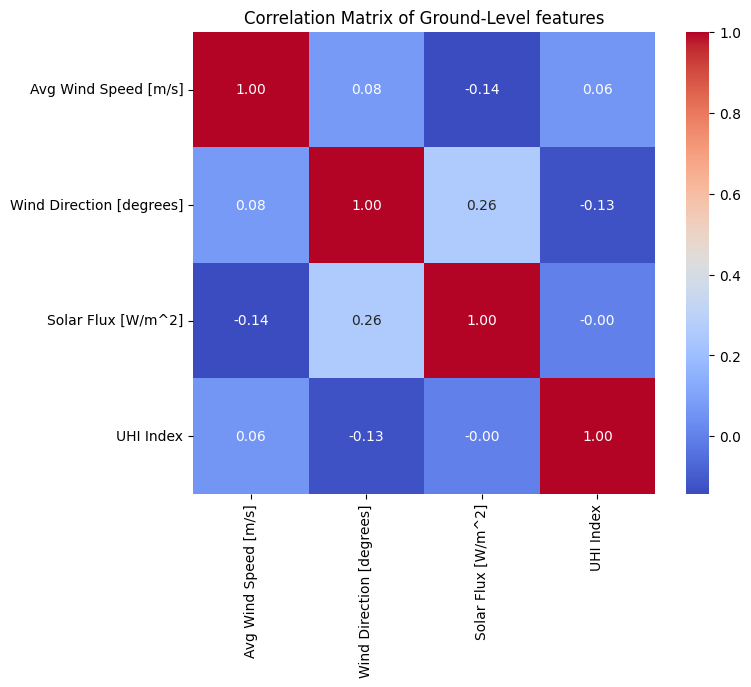

In [76]:
features = mapped_ground_df[['Avg Wind Speed [m/s]', 'Wind Direction [degrees]', 'Solar Flux [W/m^2]', 'UHI Index']]

# Compute correlation matrix
correlation_matrix = features.corr()

# Plot the heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", square=True)
plt.title("Correlation Matrix of Ground-Level features")
plt.show()

### 🛰️ Satellite EDA

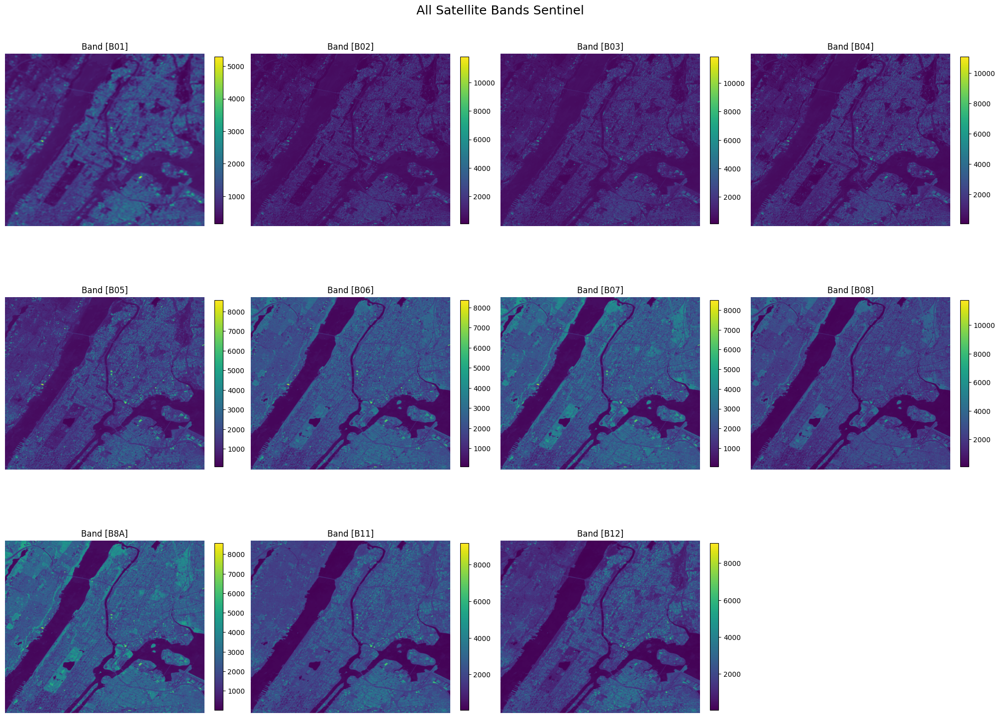

In [77]:
import math

# Get the list of band names from the median composite
band_names = list(median_sentinel.data_vars)
num_bands = len(band_names)

cols = 4
rows = math.ceil(num_bands / cols)

fig, axes = plt.subplots(rows, cols, figsize=(20, rows * 5), constrained_layout=True)
axes = axes.flatten()

# Plot each band
for i, band in enumerate(band_names):
  im = axes[i].imshow(median_sentinel[band], cmap='viridis')
  axes[i].set_title(f"Band [{band}]", fontsize=12)
  axes[i].axis('off')
  fig.colorbar(im, ax=axes[i], shrink=0.7)

# Turn off any unused axes
for j in range(i + 1, len(axes)):
  axes[j].remove()

plt.suptitle("All Satellite Bands Sentinel", fontsize=18)
plt.show()

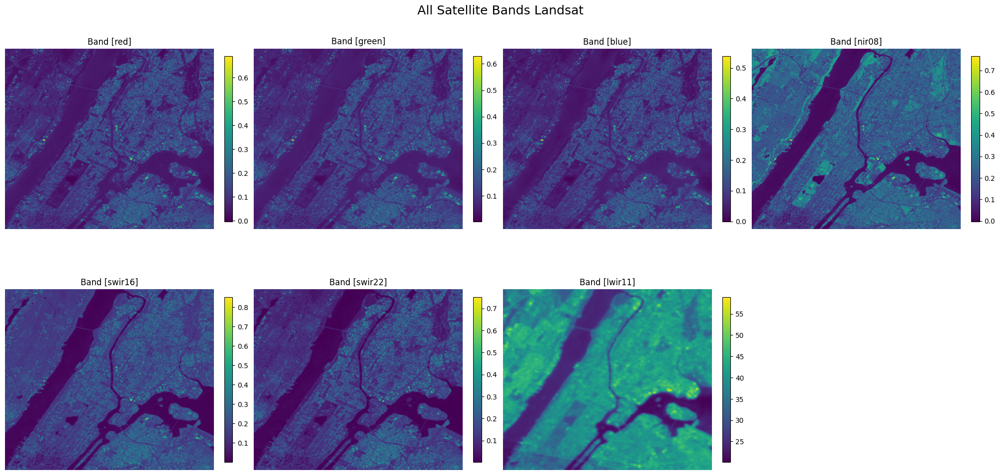

In [78]:
# Get the list of band names from the median composite
band_names = list(median_landsat.data_vars)
num_bands = len(band_names)

cols = 4
rows = math.ceil(num_bands / cols)

fig, axes = plt.subplots(rows, cols, figsize=(20, rows * 5), constrained_layout=True)
axes = axes.flatten()

# Plot each band
for i, band in enumerate(band_names):
  im = axes[i].imshow(median_landsat[band], cmap='viridis')
  axes[i].set_title(f"Band [{band}]", fontsize=12)
  axes[i].axis('off')
  fig.colorbar(im, ax=axes[i], shrink=0.7)

# Turn off any unused axes
for j in range(i + 1, len(axes)):
  axes[j].remove()

plt.suptitle("All Satellite Bands Landsat", fontsize=18)
plt.show()

The <b>Normalized Difference Vegetation Index (NDVI)</b> is used to measure the "greenness" of vegetation and has a range of 0.0 to 1.0. Low values (0.0 to 0.25) reflect a lack of vegetation (bare soil, urban, water), middle values (0.25 to 0.6) reflect grasslands or croplands in their growing state, and high values (0.6 to 1.0) reflect dense vegetation such as trees or croplands at their peak vegetation state. Such information can be relevant to modeling urban heating as the proximity to vegetation or "green space" can mitigate urban heating. The equation uses two spectral bands where: <b>NDVI = (NIR-Red) / (NIR+Red).

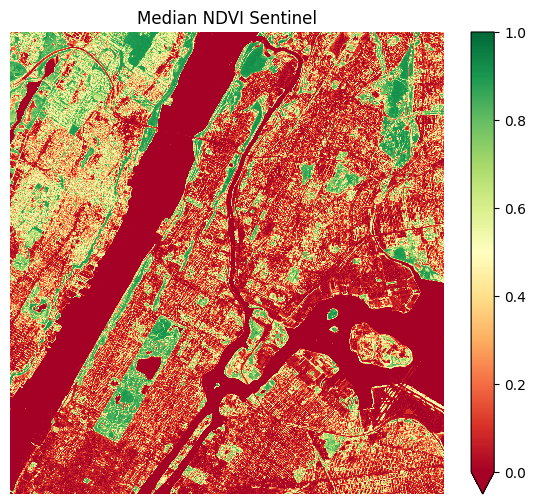

In [79]:
# Calculate NDVI for the median mosaic (Sentinel)
ndvi_median_sentinel = (median_sentinel.B08 - median_sentinel.B04) / (median_sentinel.B08 + median_sentinel.B04)

fig, ax = plt.subplots(figsize=(7,6))
ndvi_median_sentinel.plot.imshow(vmin=0.0, vmax=1.0, cmap="RdYlGn")
plt.title("Median NDVI Sentinel")
plt.axis('off')
plt.show()

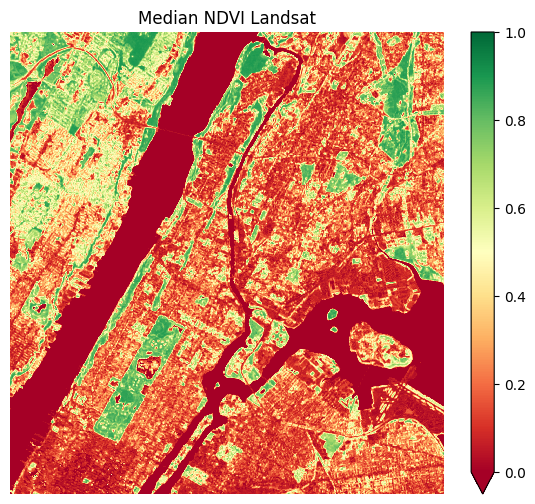

In [80]:
# Calculate NDVI for the median mosaic (Sentinel)
ndvi_median_landsat = (median_landsat.nir08 - median_landsat.red) / (median_landsat.nir08 + median_landsat.red)

fig, ax = plt.subplots(figsize=(7,6))
ndvi_median_landsat.plot.imshow(vmin=0.0, vmax=1.0, cmap="RdYlGn")
plt.title("Median NDVI Landsat")
plt.axis('off')
plt.show()

The <b>Normalized Difference Buildup Index (NDBI)</b> is a ratio-based index that uses the Near Infra-red (NIR) and shortwave-infrared (SWIR) band (1.6 um, Band-11) to highlight built-up areas or areas of urbanization. Low values (below zero) reflect a lack of urbanization and are typical of water or vegetation. High values (above zero) reflect urbanization with the highest densities where the colors are dark red. Such information can be relevant to modeling urban heating as urban density and increase urban heating. The equation uses two spectral bands where: <b>NDBI = (SWIR-NIR) / (SWIR+NIR).

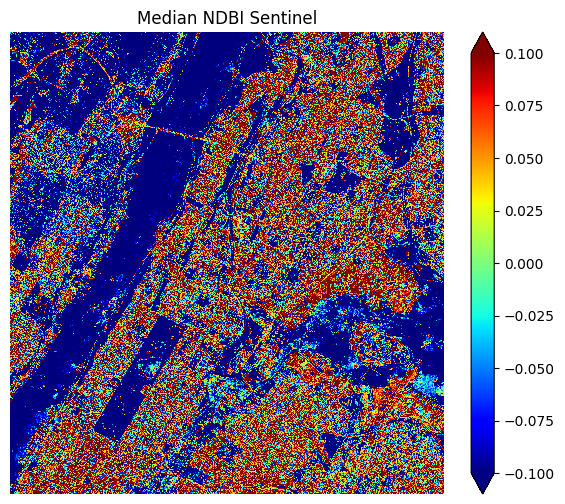

In [81]:
# Calculate NDBI for the median mosaic (Sentinel)
ndbi_median_sentinel = (median_sentinel.B11 - median_sentinel.B08) / (median_sentinel.B11 + median_sentinel.B08)

fig, ax = plt.subplots(figsize=(7,6))
ndbi_median_sentinel.plot.imshow(vmin=-0.1, vmax=0.1, cmap="jet")
plt.title("Median NDBI Sentinel")
plt.axis('off')
plt.show()

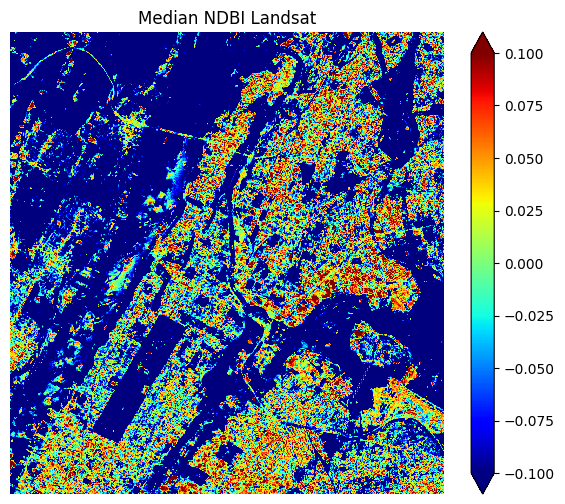

In [82]:
# Calculate NDBI for the median mosaic (Landsat)
ndbi_median_landsat = (median_landsat.swir16 - median_landsat.nir08) / (median_landsat.swir16 + median_landsat.nir08)

fig, ax = plt.subplots(figsize=(7,6))
ndbi_median_landsat.plot.imshow(vmin=-0.1, vmax=0.1, cmap="jet")
plt.title("Median NDBI Landsat")
plt.axis('off')
plt.show()

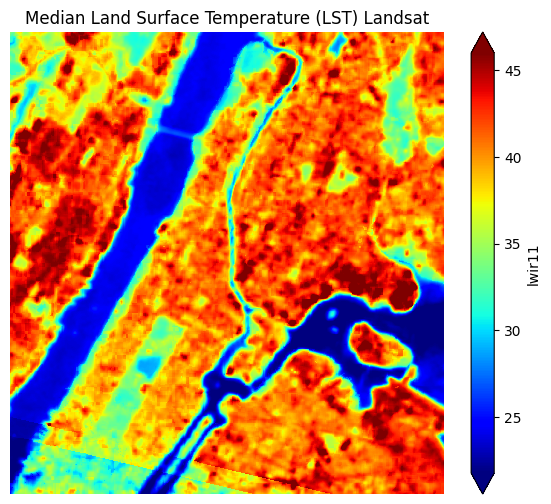

In [83]:
# Calculate Land Surface Temperature
fig, ax = plt.subplots(figsize=(7,6))
median_landsat.lwir11.plot.imshow(robust=True, cmap="jet")
plt.title("Median Land Surface Temperature (LST) Landsat")
plt.axis('off')
plt.show()

In [84]:
# Calculate NDVI Sentinel (Normalized Difference Vegetation Index) and handle division by zero by replacing infinities with NaN. (Sentinel)
mapped_satellite_combined_df['NDVI_Sentinel'] = (mapped_satellite_combined_df['B08'] - mapped_satellite_combined_df['B04']) / (mapped_satellite_combined_df['B08'] + mapped_satellite_combined_df['B04'])
mapped_satellite_combined_df['NDVI_Sentinel'] = mapped_satellite_combined_df['NDVI_Sentinel'].replace([np.inf, -np.inf], np.nan)

# Calculate NDVI Landsat (Normalized Difference Vegetation Index) and handle division by zero by replacing infinities with NaN (Landsat)
mapped_satellite_combined_df['NDVI_Landsat'] = (mapped_satellite_combined_df['nir08'] - mapped_satellite_combined_df['red']) / (mapped_satellite_combined_df['nir08'] + mapped_satellite_combined_df['red'])
mapped_satellite_combined_df['NDVI_Landsat'] = mapped_satellite_combined_df['NDVI_Landsat'].replace([np.inf, -np.inf], np.nan)

In [85]:
# Calculate NDVI Combined (Normalized Difference Vegetation Index) and handle division by zero by replacing infinities with NaN. (Sentinel)
final_combined_df['NDVI_Sentinel'] = (final_combined_df['B08'] - final_combined_df['B04']) / (final_combined_df['B08'] + final_combined_df['B04'])
final_combined_df['NDVI_Sentinel'] = final_combined_df['NDVI_Sentinel'].replace([np.inf, -np.inf], np.nan)

# Calculate NDVI Combined (Normalized Difference Vegetation Index) and handle division by zero by replacing infinities with NaN. (Landsat)
final_combined_df['NDVI_Landsat'] = (final_combined_df['nir08'] - final_combined_df['red']) / (final_combined_df['nir08'] + final_combined_df['red'])
final_combined_df['NDVI_Landsat'] = final_combined_df['NDVI_Landsat'].replace([np.inf, -np.inf], np.nan)

In [86]:
# Calculate NDBI (Normalized Difference Built-up Index) and handle division vy zero by replacing infinities with NaN. (Sentinel)
mapped_satellite_combined_df['NDBI_Sentinel'] = (mapped_satellite_combined_df['B11'] - mapped_satellite_combined_df['B08']) / (mapped_satellite_combined_df['B11'] + mapped_satellite_combined_df['B08'])
mapped_satellite_combined_df['NDBI_Sentinel'] = mapped_satellite_combined_df['NDBI_Sentinel'].replace([np.inf, -np.inf], np.nan)

# Calculate NDBI (Normalized Difference Built-up Index) and handle division vy zero by replacing infinities with NaN. (Landsat)
mapped_satellite_combined_df['NDBI_Landsat'] = (mapped_satellite_combined_df['swir16'] - mapped_satellite_combined_df['nir08']) / (mapped_satellite_combined_df['swir16'] + mapped_satellite_combined_df['nir08'])
mapped_satellite_combined_df['NDBI_Landsat'] = mapped_satellite_combined_df['NDBI_Landsat'].replace([np.inf, -np.inf], np.nan)

In [87]:
# Calculate NDBI (Normalized Difference Built-up Index) and handle division vy zero by replacing infinities with NaN. (Sentinel)
final_combined_df['NDBI_Sentinel'] = (final_combined_df['B11'] - final_combined_df['B08']) / (final_combined_df['B11'] + final_combined_df['B08'])
final_combined_df['NDBI_Sentinel'] = final_combined_df['NDBI_Sentinel'].replace([np.inf, -np.inf], np.nan)

# Calculate NDBI (Normalized Difference Built-up Index) and handle division vy zero by replacing infinities with NaN. (Landsat)
final_combined_df['NDBI_Landsat'] = (final_combined_df['swir16'] - final_combined_df['nir08']) / (final_combined_df['swir16'] + final_combined_df['nir08'])
final_combined_df['NDBI_Landsat'] = final_combined_df['NDBI_Landsat'].replace([np.inf, -np.inf], np.nan)

In [88]:
mapped_satellite_combined_df

,Longitude,Latitude,datetime,UHI Index,B01,B02,B03,B04,B05,B06,...,green,blue,nir08,swir16,swir22,lwir11,NDVI_Sentinel,NDVI_Landsat,NDBI_Sentinel,NDBI_Landsat
0,-73.909167,40.813107,2021-07-24 15:53:00,1.030289,825.0,990.0,1144.0,1172.0,1435.0,1688.0,...,0.111162,0.089108,0.196248,0.164293,0.125188,42.232378,0.219187,0.241248,-0.011609,-0.088631
1,-73.909187,40.813045,2021-07-24 15:53:00,1.030289,825.0,622.0,785.0,744.0,1114.0,2006.0,...,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815,0.514043,0.464694,-0.193615,-0.187427
2,-73.909242,40.812908,2021-07-24 15:53:00,1.023798,825.0,619.0,750.0,738.0,1114.0,2006.0,...,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815,0.514474,0.464694,-0.190279,-0.187427
3,-73.909257,40.812845,2021-07-24 15:53:00,1.021634,825.0,556.0,758.0,660.0,1056.0,1891.0,...,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815,0.551020,0.464694,-0.157948,-0.187427
4,-73.909280,40.812777,2021-07-24 15:53:00,1.021634,825.0,519.0,746.0,623.0,1056.0,1891.0,...,0.085780,0.062790,0.210108,0.156537,0.110310,41.152283,0.612442,0.430154,-0.219765,-0.146109
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8478,-73.956973,40.790482,2021-07-24 15:57:00,0.976797,363.0,295.0,461.0,299.0,824.0,2565.0,...,0.060535,0.046840,0.321483,0.153238,0.072470,34.941741,0.820042,0.759716,-0.261314,-0.354409
8479,-73.957017,40.790413,2021-07-24 15:57:00,0.976797,432.0,383.0,549.0,336.0,976.0,2545.0,...,0.060535,0.046840,0.321483,0.153238,0.072470,34.941741,0.825273,0.759716,-0.292342,-0.354409
8480,-73.957050,40.790333,2021-07-24 15:57:00,0.972470,432.0,604.0,744.0,597.0,976.0,2545.0,...,0.071260,0.052588,0.343208,0.183680,0.091940,35.081880,0.670075,0.719455,-0.222492,-0.302773
8481,-73.957063,40.790308,2021-07-24 15:57:00,0.972470,432.0,466.0,737.0,476.0,976.0,2545.0,...,0.071260,0.052588,0.343208,0.183680,0.091940,35.081880,0.766208,0.719455,-0.303371,-0.302773


In [89]:
final_combined_df

,Longitude,Latitude,datetime,UHI Index,Date / Time,Avg Wind Speed [m/s],Wind Direction [degrees],Solar Flux [W/m^2],Borough,time_difference,...,green,blue,nir08,swir16,swir22,lwir11,NDVI_Sentinel,NDVI_Landsat,NDBI_Sentinel,NDBI_Landsat
0,-73.909167,40.813107,2021-07-24 15:53:00,1.030289,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,0.111162,0.089108,0.196248,0.164293,0.125188,42.232378,0.219187,0.241248,-0.011609,-0.088631
1,-73.909187,40.813045,2021-07-24 15:53:00,1.030289,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815,0.514043,0.464694,-0.193615,-0.187427
2,-73.909242,40.812908,2021-07-24 15:53:00,1.023798,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815,0.514474,0.464694,-0.190279,-0.187427
3,-73.909257,40.812845,2021-07-24 15:53:00,1.021634,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815,0.551020,0.464694,-0.157948,-0.187427
4,-73.909280,40.812777,2021-07-24 15:53:00,1.021634,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,0.085780,0.062790,0.210108,0.156537,0.110310,41.152283,0.612442,0.430154,-0.219765,-0.146109
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8236,-73.956973,40.790482,2021-07-24 15:57:00,0.976797,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,0.060535,0.046840,0.321483,0.153238,0.072470,34.941741,0.820042,0.759716,-0.261314,-0.354409
8237,-73.957017,40.790413,2021-07-24 15:57:00,0.976797,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,0.060535,0.046840,0.321483,0.153238,0.072470,34.941741,0.825273,0.759716,-0.292342,-0.354409
8238,-73.957050,40.790333,2021-07-24 15:57:00,0.972470,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,0.071260,0.052588,0.343208,0.183680,0.091940,35.081880,0.670075,0.719455,-0.222492,-0.302773
8239,-73.957063,40.790308,2021-07-24 15:57:00,0.972470,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,0.071260,0.052588,0.343208,0.183680,0.091940,35.081880,0.766208,0.719455,-0.303371,-0.302773


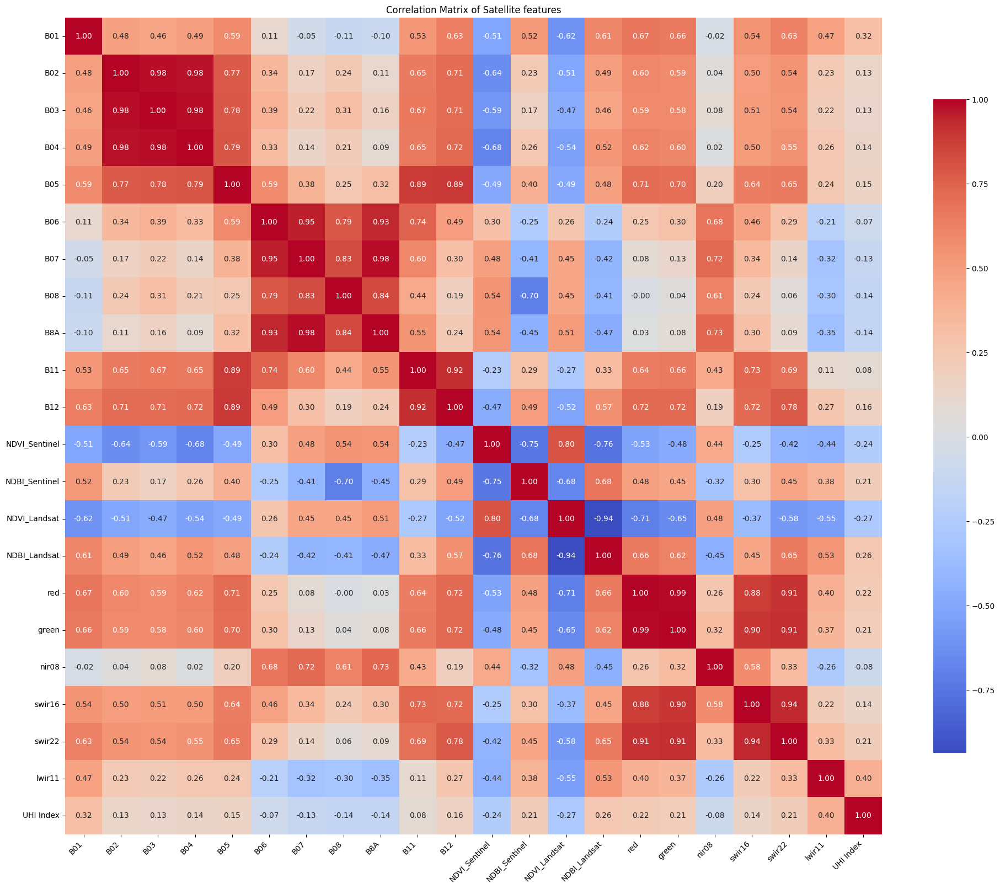

In [90]:
features = mapped_satellite_combined_df[['B01', 'B02', 'B03', 'B04', 'B05', 'B06', 'B07', 'B08', 'B8A', 'B11', 'B12', 'NDVI_Sentinel', 'NDBI_Sentinel', 'NDVI_Landsat', 'NDBI_Landsat', 'red', 'green', 'nir08', 'swir16', 'swir22', 'lwir11', 'UHI Index']]

# Compute correlation matrix
correlation_matrix = features.corr()

# Plot the heatmap
plt.figure(figsize=(20, 16))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", square=True, cbar_kws={'shrink': 0.8})
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.title("Correlation Matrix of Satellite features")
plt.show()

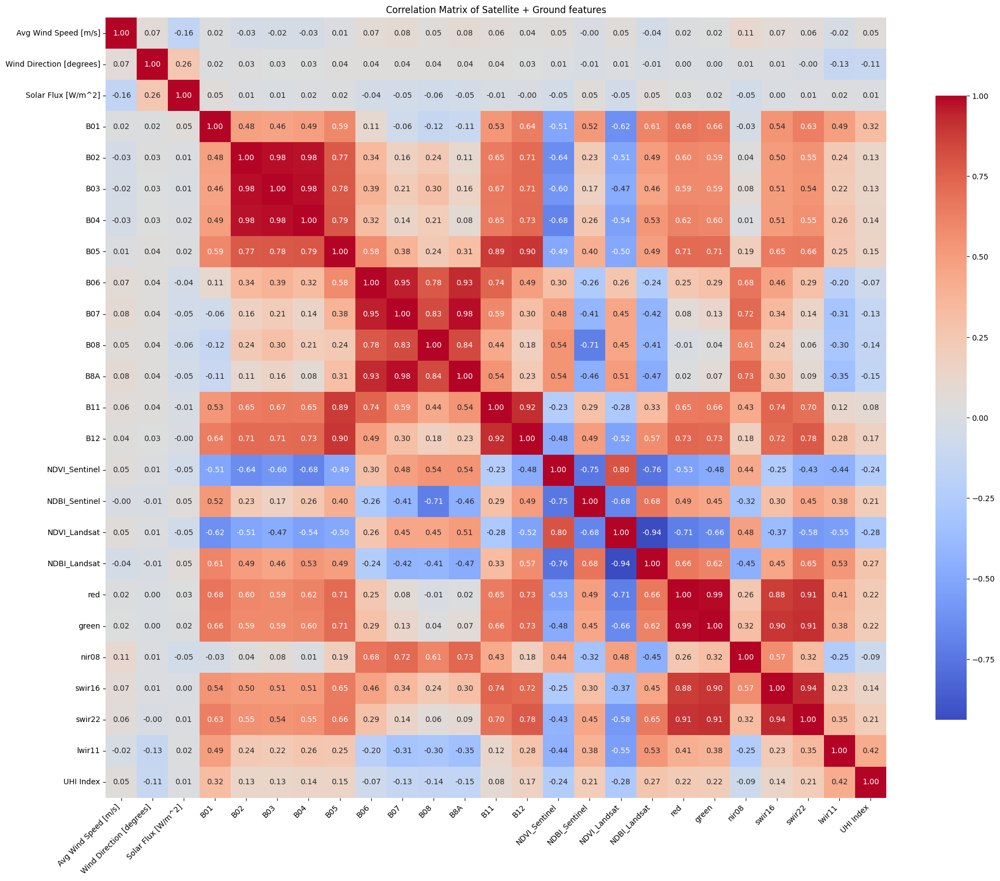

In [91]:
features = final_combined_df[['Avg Wind Speed [m/s]', 'Wind Direction [degrees]', 'Solar Flux [W/m^2]', 'B01', 'B02', 'B03', 'B04', 'B05', 'B06', 'B07', 'B08', 'B8A', 'B11', 'B12', 'NDVI_Sentinel', 'NDBI_Sentinel', 'NDVI_Landsat', 'NDBI_Landsat', 'red', 'green', 'nir08', 'swir16', 'swir22', 'lwir11', 'UHI Index']]

# Compute correlation matrix
correlation_matrix = features.corr()

# Plot the heatmap
plt.figure(figsize=(20, 16))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", square=True, cbar_kws={'shrink': 0.8})
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.title("Correlation Matrix of Satellite + Ground features")
plt.show()

## ⚙️ Model Training

**Regression models** are designed to handle problem with numeric target variable. To access predictive performance and interpretability, different regression model will be compared.

Model | Description
--- | ---
**Random Forest** | Non-linear model that handles complex relationship between variables.
**XGBoost** | An optimized gradient boosting framework that offers regularization and high performance for structured data problems
**Gradient Boosting** | Non-linear model that builds trees sequentially to improve errors.
**Linear Regression** | A simple baseline model that evaluates whether more complex models are necessary.


In [92]:
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from xgboost import XGBRegressor
from sklearn.metrics import r2_score, mean_squared_error

import shap

### 📍 Ground-Level Training

In [93]:
mapped_ground_df.head()

,Longitude,Latitude,datetime,UHI Index,Date / Time,Avg Wind Speed [m/s],Wind Direction [degrees],Solar Flux [W/m^2],Borough,time_difference
0,-73.909167,40.813107,2021-07-24 15:53:00,1.030289,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
1,-73.909187,40.813045,2021-07-24 15:53:00,1.030289,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
2,-73.909215,40.812978,2021-07-24 15:53:00,1.023798,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
3,-73.909242,40.812908,2021-07-24 15:53:00,1.023798,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00
4,-73.909257,40.812845,2021-07-24 15:53:00,1.021634,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00


In [94]:
# Set ground-level as input features
X_ground = mapped_ground_df[['Avg Wind Speed [m/s]', 'Wind Direction [degrees]', 'Solar Flux [W/m^2]']]

# Select 'UHI index' as target variable
y_ground = mapped_ground_df['UHI Index']

In [95]:
# Split data into training (80%) and testing (20%) sets
X_train_ground, X_test_ground, y_train_ground, y_test_ground = train_test_split(X_ground, y_ground, test_size=0.2, random_state=42)

# Scale or standardizes numerical features
scaler = StandardScaler()
X_train_scaled_ground = scaler.fit_transform(X_train_ground)
X_test_scaled_ground = scaler.transform(X_test_ground)

# Restore column names after scaling
X_train_scaled_ground_named = pd.DataFrame(X_train_scaled_ground, columns=X_ground.columns)
X_test_scaled_ground_named = pd.DataFrame(X_test_scaled_ground, columns=X_ground.columns)

In [96]:
# Train different models
models_ground_level = {
    "RandomForest": RandomForestRegressor(n_estimators=100, random_state=42),
    "XGBoost": XGBRegressor(n_estimators=100, learning_rate=0.1, max_dept=3, random_state=42),
    "GradientBoosting": GradientBoostingRegressor(n_estimators=100, random_state=42),
    "LinearRegression": LinearRegression()
}

### 🛰️ Satellite Training

In [97]:
mapped_satellite_combined_df.head()

,Longitude,Latitude,datetime,UHI Index,B01,B02,B03,B04,B05,B06,...,green,blue,nir08,swir16,swir22,lwir11,NDVI_Sentinel,NDVI_Landsat,NDBI_Sentinel,NDBI_Landsat
0,-73.909167,40.813107,2021-07-24 15:53:00,1.030289,825.0,990.0,1144.0,1172.0,1435.0,1688.0,...,0.111162,0.089108,0.196248,0.164293,0.125188,42.232378,0.219187,0.241248,-0.011609,-0.088631
1,-73.909187,40.813045,2021-07-24 15:53:00,1.030289,825.0,622.0,785.0,744.0,1114.0,2006.0,...,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815,0.514043,0.464694,-0.193615,-0.187427
2,-73.909242,40.812908,2021-07-24 15:53:00,1.023798,825.0,619.0,750.0,738.0,1114.0,2006.0,...,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815,0.514474,0.464694,-0.190279,-0.187427
3,-73.909257,40.812845,2021-07-24 15:53:00,1.021634,825.0,556.0,758.0,660.0,1056.0,1891.0,...,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815,0.551020,0.464694,-0.157948,-0.187427
4,-73.909280,40.812777,2021-07-24 15:53:00,1.021634,825.0,519.0,746.0,623.0,1056.0,1891.0,...,0.085780,0.062790,0.210108,0.156537,0.110310,41.152283,0.612442,0.430154,-0.219765,-0.146109


In [98]:
# Set satellite as input features
X_satellite = mapped_satellite_combined_df[['B01', 'B02', 'B03', 'B04', 'B05', 'B06',
                                   'B07', 'B08', 'B8A', 'B11', 'B12', 'NDVI_Sentinel',
                                   'NDBI_Sentinel', 'NDVI_Landsat', 'NDBI_Landsat',
                                   'red', 'green', 'nir08', 'swir16', 'swir22', 'lwir11']]
# Set 'UHI Index' as target variable
y_satellite = mapped_satellite_combined_df['UHI Index']

In [99]:
# Split data into training (80%) and testing (20%) sets
X_train_satellite, X_test_satellite, y_train_satellite, y_test_satellite = train_test_split(X_satellite, y_satellite, test_size=0.2, random_state=42)

# Scale or standardizes numerical features
scaler = StandardScaler()
X_train_scaled_satellite = scaler.fit_transform(X_train_satellite)
X_test_scaled_satellite = scaler.transform(X_test_satellite)

# Restore column names after scaling
X_train_scaled_satellite_named = pd.DataFrame(X_train_scaled_satellite, columns=X_satellite.columns)
X_test_scaled_satellite_named = pd.DataFrame(X_test_scaled_satellite, columns=X_satellite.columns)

In [100]:
# Train different models
models_satellite_level = {
    "RandomForest": RandomForestRegressor(n_estimators=100, random_state=42),
    "XGBoost": XGBRegressor(n_estimators=100, learning_rate=0.1, max_dept=3, random_state=42),
    "GradientBoosting": GradientBoostingRegressor(n_estimators=100, random_state=42),
    "LinearRegression": LinearRegression()
}

### 📍🛰️ Combined Data Training

In [101]:
final_combined_df.head()

,Longitude,Latitude,datetime,UHI Index,Date / Time,Avg Wind Speed [m/s],Wind Direction [degrees],Solar Flux [W/m^2],Borough,time_difference,...,green,blue,nir08,swir16,swir22,lwir11,NDVI_Sentinel,NDVI_Landsat,NDBI_Sentinel,NDBI_Landsat
0,-73.909167,40.813107,2021-07-24 15:53:00,1.030289,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,0.111162,0.089108,0.196248,0.164293,0.125188,42.232378,0.219187,0.241248,-0.011609,-0.088631
1,-73.909187,40.813045,2021-07-24 15:53:00,1.030289,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815,0.514043,0.464694,-0.193615,-0.187427
2,-73.909242,40.812908,2021-07-24 15:53:00,1.023798,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815,0.514474,0.464694,-0.190279,-0.187427
3,-73.909257,40.812845,2021-07-24 15:53:00,1.021634,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,0.071425,0.052175,0.191820,0.131265,0.085037,41.442815,0.551020,0.464694,-0.157948,-0.187427
4,-73.909280,40.812777,2021-07-24 15:53:00,1.021634,2021-07-24 15:55:00,3.4,196.0,605.0,Manhattan,0 days 00:02:00,...,0.085780,0.062790,0.210108,0.156537,0.110310,41.152283,0.612442,0.430154,-0.219765,-0.146109


In [102]:
# Set ground-level + satellite input features
X_combined = final_combined_df[['Avg Wind Speed [m/s]', 'Wind Direction [degrees]', 'Solar Flux [W/m^2]',
                                'B01', 'B02', 'B03', 'B04', 'B05', 'B06', 'B07', 'B08', 'B8A', 'B11', 'B12',
                                'NDVI_Sentinel', 'NDBI_Sentinel', 'NDVI_Landsat', 'NDBI_Landsat', 'red', 'green',
                                'nir08', 'swir16', 'swir22', 'lwir11']]
# Select 'UHI index' as target variable
y_combined = final_combined_df['UHI Index']

In [103]:
# Split data into training (80%) and testing (20%) sets
X_train_combined, X_test_combined, y_train_combined, y_test_combined = train_test_split(X_combined, y_combined, test_size=0.2, random_state=42)

# Scale or standardizes numerical features
scaler = StandardScaler()
X_train_scaled_combined = scaler.fit_transform(X_train_combined)
X_test_scaled_combined = scaler.transform(X_test_combined)

# Restore column names after scaling
X_train_scaled_combined_named = pd.DataFrame(X_train_scaled_combined, columns=X_combined.columns)
X_test_scaled_combined_named = pd.DataFrame(X_test_scaled_combined, columns=X_combined.columns)

In [104]:
# Train different models
models_combined_level = {
    "RandomForest": RandomForestRegressor(n_estimators=100, random_state=42),
    "XGBoost": XGBRegressor(n_estimators=100, learning_rate=0.1, max_dept=3, random_state=42),
    "GradientBoosting": GradientBoostingRegressor(n_estimators=100, random_state=42),
    "LinearRegression": LinearRegression()
}

## ✅ Model Evaluation

### 📍 Ground-Level Evaluation

In [105]:
results = []
for name, model in models_ground_level.items():
    model.fit(X_train_scaled_ground, y_train_ground)

    # In-sample prediction
    y_train_pred_ground = model.predict(X_train_scaled_ground)
    r2_insample = r2_score(y_train_ground, y_train_pred_ground)

    # Out-sample prediction
    y_test_pred_ground = model.predict(X_test_scaled_ground)
    r2_outsample = r2_score(y_test_ground, y_test_pred_ground)

    # RMSE
    rmse = math.sqrt(mean_squared_error(y_test_ground, y_test_pred_ground))
    results.append([name, r2_insample, r2_outsample, rmse])

results_mapped_ground_df = pd.DataFrame(results, columns=["Model", "R-squared Train", "R-squared Test", "RMSE"])
results_mapped_ground_df

,Model,R-squared Train,R-squared Test,RMSE
0,RandomForest,0.109831,0.104992,0.015324
1,XGBoost,0.109842,0.105106,0.015323
2,GradientBoosting,0.109814,0.105164,0.015322
3,LinearRegression,0.023181,0.021065,0.016026


In [106]:
best_ground_model = models_ground_level['XGBoost']
best_ground_model.fit(X_train_scaled_ground, y_train_ground)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             feature_weights=None, gamma=None, grow_policy=None,
             importance_type=None, interaction_constraints=None,
             learning_rate=0.1, max_bin=None, max_cat_threshold=None,
             max_cat_to_onehot=None, max_delta_step=None, max_dept=3,
             max_depth=None, max_leaves=None, min_child_weight=None,
             missing=nan, monotone_constraints=None, multi_strategy=None,
             n_estimators=100, n_jobs=None, ...)

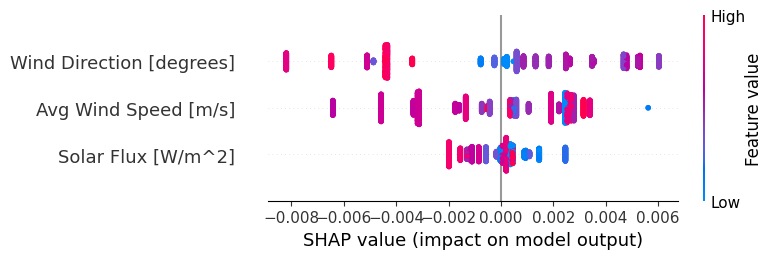

In [107]:
explainer = shap.Explainer(best_ground_model, X_train_scaled_ground_named)
shap_values = explainer(X_test_scaled_ground_named)

shap.summary_plot(shap_values.values, X_test_scaled_ground_named, feature_names=X_test_scaled_ground_named.columns)


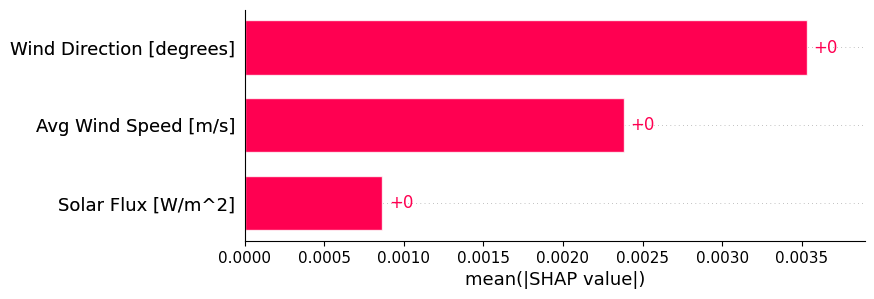

In [108]:
shap.plots.bar(shap_values)

### 🛰️ Satellite Evaluation

In [109]:
results = []
for name, model in models_satellite_level.items():
    model.fit(X_train_scaled_satellite, y_train_satellite)

    # In-sample prediction
    y_train_pred_satellite = model.predict(X_train_scaled_satellite)
    r2_insample = r2_score(y_train_satellite, y_train_pred_satellite)

    # Out-sample prediction
    y_test_pred_satellite = model.predict(X_test_scaled_satellite)
    r2_outsample = r2_score(y_test_satellite, y_test_pred_satellite)

    # RMSE
    rmse = math.sqrt(mean_squared_error(y_test_satellite, y_test_pred_satellite))
    results.append([name, r2_insample, r2_outsample, rmse])

results_mapped_satellite_df = pd.DataFrame(results, columns=["Model", "R-squared Train", "R-squared Test", "RMSE"])
results_mapped_satellite_df

,Model,R-squared Train,R-squared Test,RMSE
0,RandomForest,0.943580,0.598008,0.010453
1,XGBoost,0.726361,0.502868,0.011624
2,GradientBoosting,0.403728,0.351710,0.013274
3,LinearRegression,0.197240,0.217201,0.014586


In [110]:
best_satellite_model = models_satellite_level['RandomForest']
best_satellite_model.fit(X_train_scaled_satellite, y_train_satellite)

RandomForestRegressor(random_state=42)

 99%|===================| 1684/1697 [02:07<00:00]        

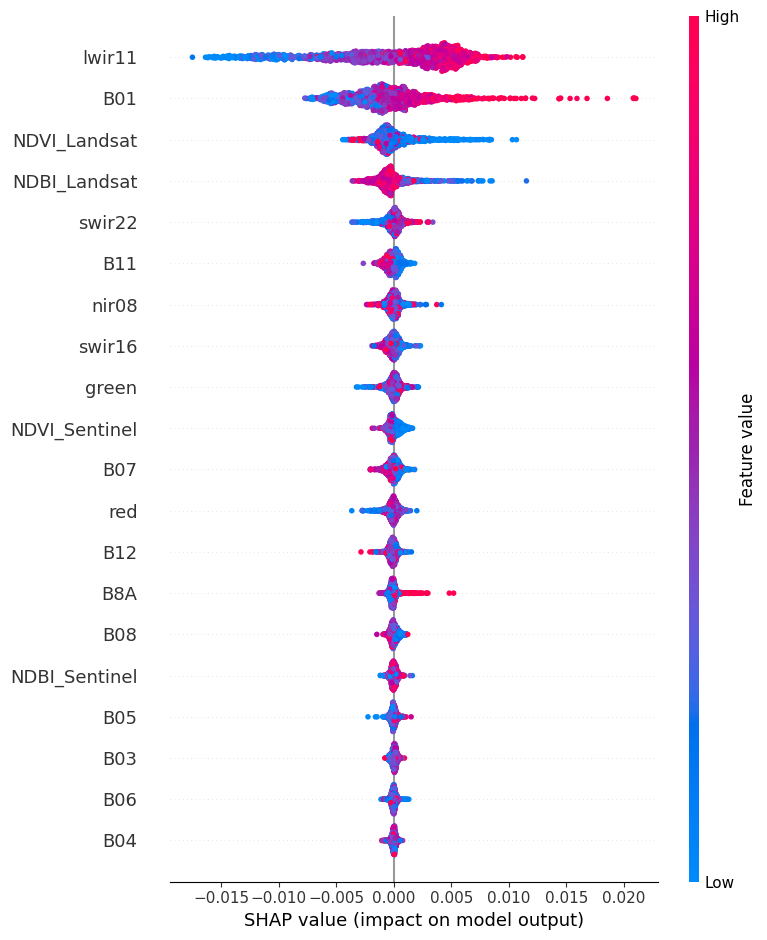

In [111]:
explainer = shap.Explainer(best_satellite_model, X_train_scaled_satellite_named)
shap_values = explainer(X_test_scaled_satellite_named)

shap.summary_plot(shap_values.values, X_test_scaled_satellite_named, feature_names=X_test_scaled_satellite_named.columns)

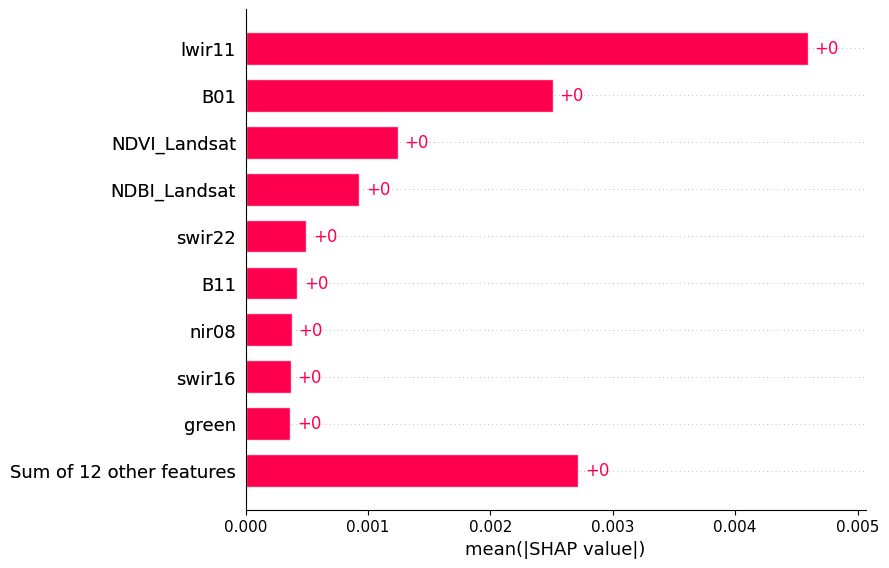

In [112]:
shap.plots.bar(shap_values)

### 📍🛰️ Combined Data Evaluation

In [113]:
results = []
for name, model in models_combined_level.items():
    model.fit(X_train_scaled_combined, y_train_combined)

    # In-sample prediction
    y_train_pred_combined = model.predict(X_train_scaled_combined)
    r2_insample = r2_score(y_train_combined, y_train_pred_combined)

    # Out-sample prediction
    y_test_pred_combined = model.predict(X_test_scaled_combined)
    r2_outsample = r2_score(y_test_combined, y_test_pred_combined)

    # RMSE
    rmse = math.sqrt(mean_squared_error(y_test_combined, y_test_pred_combined))
    results.append([name, r2_insample, r2_outsample, rmse])

results_mapped_combined_df = pd.DataFrame(results, columns=["Model", "R-squared Train", "R-squared Test", "RMSE"])
results_mapped_combined_df

,Model,R-squared Train,R-squared Test,RMSE
0,RandomForest,0.963444,0.756475,0.008159
1,XGBoost,0.804582,0.646479,0.009830
2,GradientBoosting,0.478963,0.438769,0.012386
3,LinearRegression,0.218481,0.252728,0.014292


In [114]:
best_combined_model = models_combined_level['RandomForest']
best_combined_model.fit(X_train_scaled_combined, y_train_combined)

RandomForestRegressor(random_state=42)

100%|===================| 1641/1649 [01:58<00:00]        

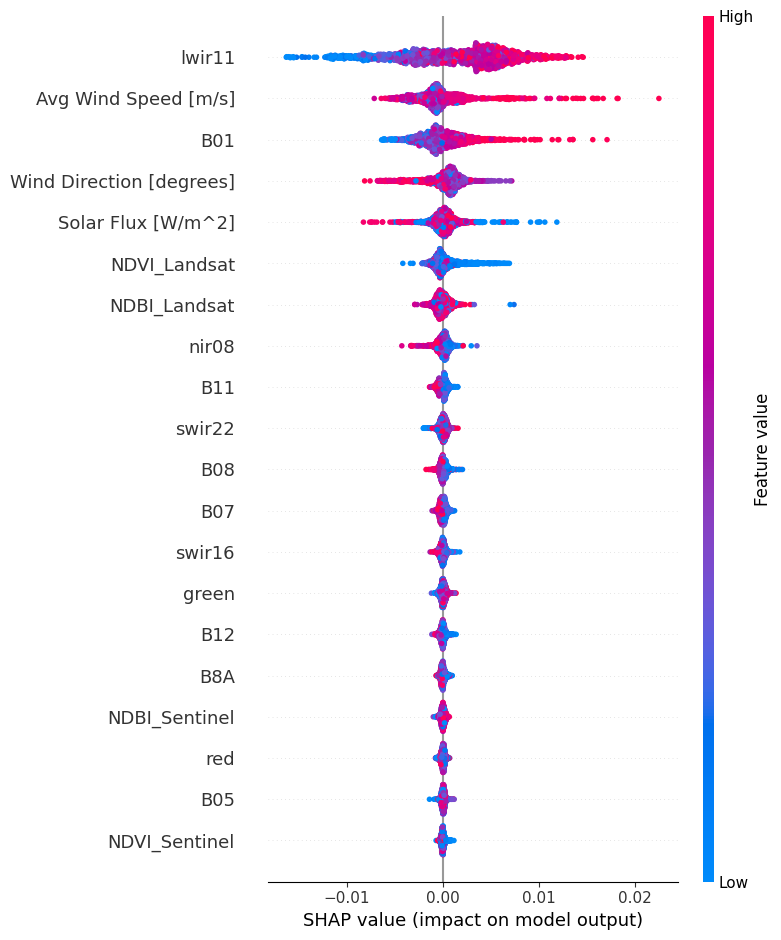

In [115]:
explainer = shap.Explainer(best_combined_model, X_train_scaled_combined_named)
shap_values = explainer(X_test_scaled_combined_named)

shap.summary_plot(shap_values.values, X_test_scaled_combined_named, feature_names=X_test_scaled_combined_named.columns)

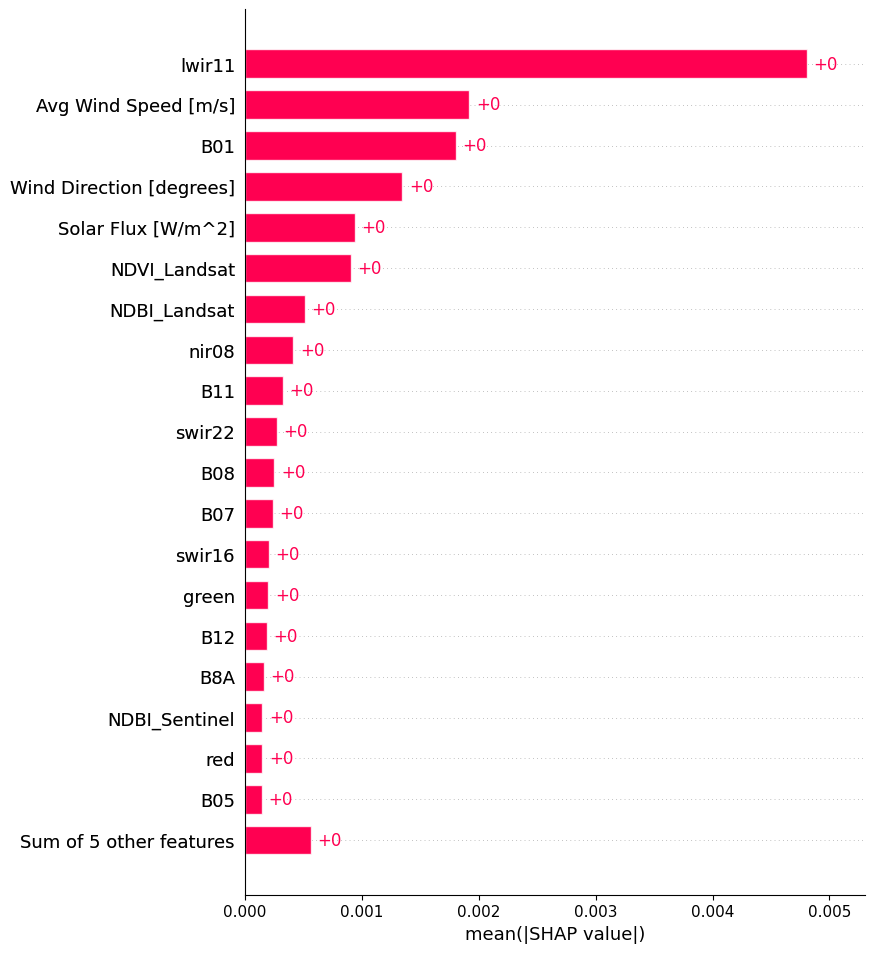

In [116]:
shap.plots.bar(shap_values, max_display=20)

In [117]:
# Save model to be later used in the data product
import joblib
base_dir = os.path.dirname(os.getcwd())
model_path = os.path.join(base_dir, "model", "uhi_prediction.pkl")

joblib.dump(best_combined_model, model_path)

print(f"Model saved to {model_path}")

Model saved to /Users/nqb/Documents/uhi-severity-prediction/model/uhi_prediction.pkl
